In [2]:
import os
import json
import re
import math
import datetime

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

from skimage.io import imread, imsave
from skimage.transform import warp
from scipy.optimize import curve_fit
from scipy.signal import savgol_filter, find_peaks
import scipy.stats as stats
from scipy.stats import gaussian_kde
from scipy.integrate import odeint, solve_ivp
#from numba import njit, prange
from skimage.filters import gaussian
from scipy.ndimage import uniform_filter1d
from numpy.polynomial import Polynomial
#from sklearn.metrics import r2_score

In [3]:
def plot_quivers(images, pos, vel, w, h, tf, normed=False):
    for t in range(tf):
        print(t)
        im = images[t]
        fig, ax = plt.subplots()
        #ax.imshow(im / np.max(im), cmap='gray')#, origin='upper', extent=[w, 0, h, 0])
        ax.imshow(im, cmap='gray')#, origin='upper', extent=[w, 0, h, 0])
        
        #plt.imshow(im/np.max(im),cmap='gray')#, origin='lower')
        if normed:
            norm = np.sqrt(vel[:,:,t,0]**2 + vel[:,:,t,1]**2)
        else:
            norm = 1
        vx = vel[:,:,t,0]
        vy = vel[:,:,t,1]


        ax.quiver(w/2+pos[:,:,t,1],h/2+pos[:,:,t,0], vy/norm, -vx/norm,cmap='gray')
        # Remove axis labels and ticks
        ax.set_xticks([])
        ax.set_yticks([])
        ax.axis('off')        
        plt.tight_layout()
        plt.savefig(f'Quivers/quiver_{t}.png', bbox_inches='tight', pad_inches=0, dpi=300)
        plt.show()

#### Example quiver

In [4]:
exp_sum = pd.read_excel('../Exps_summary.xlsx')
exp_sum['formatted_dates'] = exp_sum['Date'].dt.strftime('%Y_%m_%d')
exp_sum

,Date,Machine,Strain,DNA,Chemical,Dilution,formatted_dates
0,2023-11-15,Ti scope,MC4100 & DHL708,pLPT20&pLPT41,-,10^(-5),2023_11_15
1,2023-11-15,Tweez scope,MC4100 & DHL708,pLPT20&pLPT41,-,10^(-6),2023_11_15
2,2023-11-17,Ti scope,DHL708,pLPT119&pLPT41,-,10^(-5),2023_11_17
3,2023-11-17,Tweez scope,MC4100 & DHL708,pLPT119&pLPT41,-,10^(-6),2023_11_17
4,2023-11-28,Ti scope,MC4100 & MG1655,pAAA,-,10^(-6),2023_11_28
5,2023-11-28,Tweez scope,MG1655,pAAA,-,10^(-5),2023_11_28
6,2023-11-30,Ti scope,MC4100,pAAA,-,10^(-6),2023_11_30
7,2023-11-30,Tweez scope,MC4100,pAAA,-,10^(-5),2023_11_30
8,2023-12-04,Ti scope,MC4100,pLPT107&pLPT41,IPTG,10^(-6),2023_12_04
9,2023-12-04,Tweez scope,MC4100,pLPT107&pLPT41,IPTG,10^(-5),2023_12_04


In [5]:
#path_ext = '/media/guillermo/Expansion/Thesis GY/3. Analyzed files'
path_ext = '/media/c1046372/Expansion/Thesis GY/3. Analyzed files'
#path_ext = '/Volumes/Expansion/Thesis GY/3. Analyzed files'
folder_results = 'results'
folder_velocity = 'velocity_data'
exp_date = '2023_11_30'
vector = 'pAAA'
scope_name = 'Ti scope'
pos = 0
scopes = {'Tweez scope': 'TiTweez', 'Ti scope': 'Ti'}
dnas = {'pLPT20&pLPT41': 'pLPT20&41', 'pLPT119&pLPT41': 'pLPT119&41', 'pAAA': 'pAAA', 'pLPT107&pLPT41': 'pLPT107&41'}

path_scope = os.path.join(path_ext, scope_name)
path = os.path.join(path_scope, exp_date)
path_results = os.path.join(path,folder_results, f"pos{pos}")
path_velocity = os.path.join(path,folder_velocity, f"pos{pos}")
fname = f'{exp_date}_10x_1.0x_{dnas[vector]}_{scopes[scope_name]}_Pos{pos}.ome.tif'
fname

'2023_11_30_10x_1.0x_pAAA_Ti_Pos0.ome.tif'

In [57]:
radius = np.load(os.path.join(path_results,'radius.npy'))

In [58]:
radius

array([ 60.791264  ,  64.48072373,  68.95126148,  74.07660986,
        78.46495918,  84.00553658,  90.78194349,  97.63740462,
       106.04363092, 114.04028683, 123.77115937, 132.68774666,
       141.99207087, 151.58336797, 160.49185646, 169.15811307,
       177.40420902, 185.89169224, 194.42205534, 203.11138444,
       212.08426013, 219.88343556, 228.7981802 , 236.41361275,
       243.82717726, 252.01660975, 259.75523709, 267.19544544,
       274.78639221, 282.06883786, 288.98239879, 296.65214918,
       303.28955519, 309.85618606, 316.49325925, 322.77808249,
       329.38091426, 335.67241491, 340.91105983, 347.58703294,
       353.12814878, 359.13093414, 363.73911092, 369.30507299,
       373.94322163, 378.7948024 , 383.13250172, 387.19645092,
       391.37884682, 395.51943281, 399.91411691, 404.63683225,
       407.66006278, 410.92642873, 413.71180062, 417.02732454,
       420.19020617, 423.15234295, 424.83588029, 428.08198347,
       429.69546886, 432.44754347, 434.92064584, 437.27

In [6]:
if vector == 'pLPT20&pLPT41' or vector == 'pLPT119&pLPT41':
    yfp_chn = 0
    cfp_chn = 1
    ph_chn = 2
    fluo_chns = 2
else:
    rfp_chn = 0
    yfp_chn = 1
    cfp_chn = 2
    ph_chn = 3
    fluo_chns = 3

In [7]:
im_all = imread(os.path.join(path,fname))

In [8]:
pos = np.load(os.path.join(path_velocity,'pos.np.npy'))
vel = np.load(os.path.join(path_velocity,'vel.np.npy'))

0


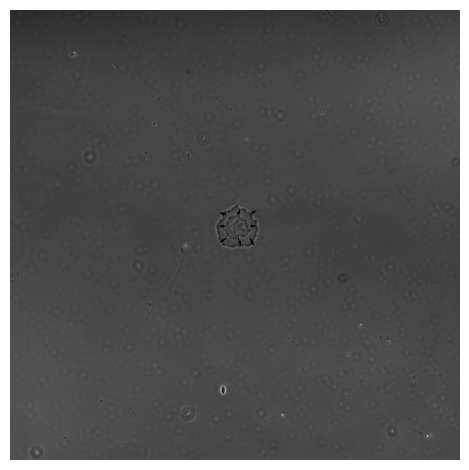

1


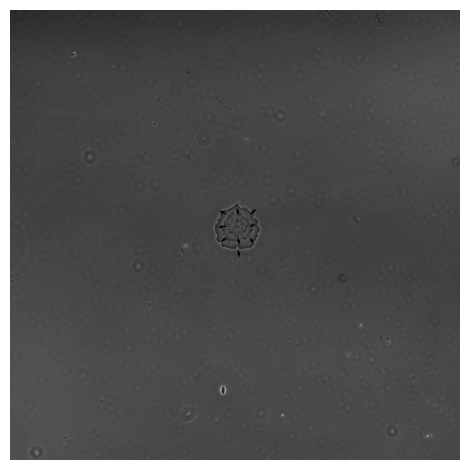

2


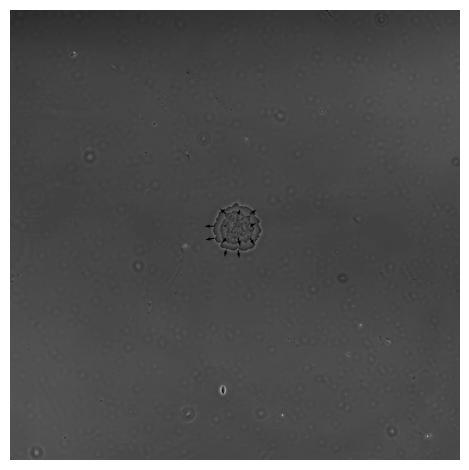

3


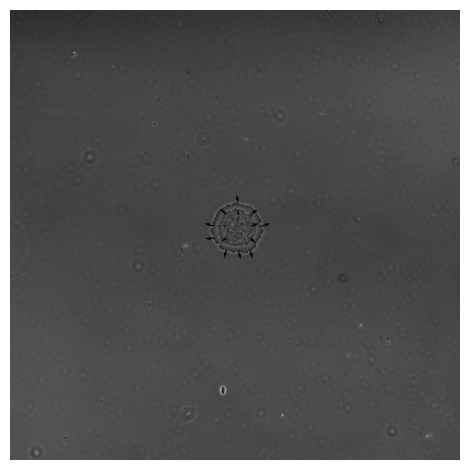

4


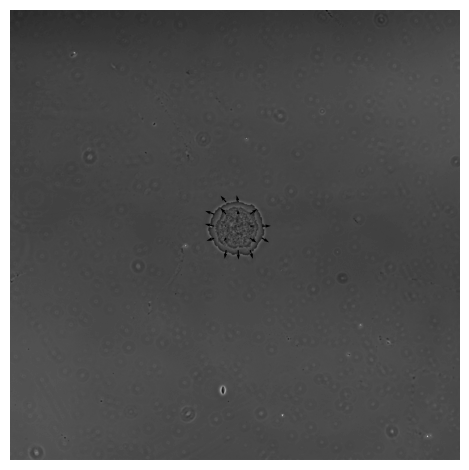

5


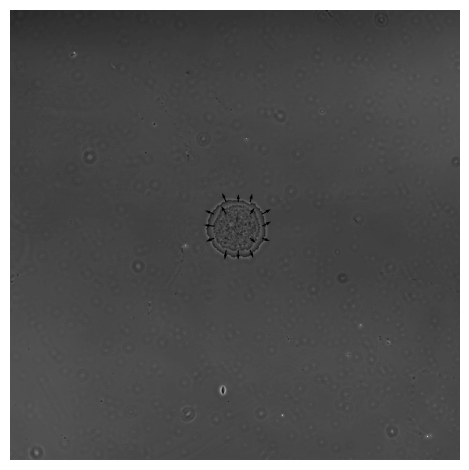

6


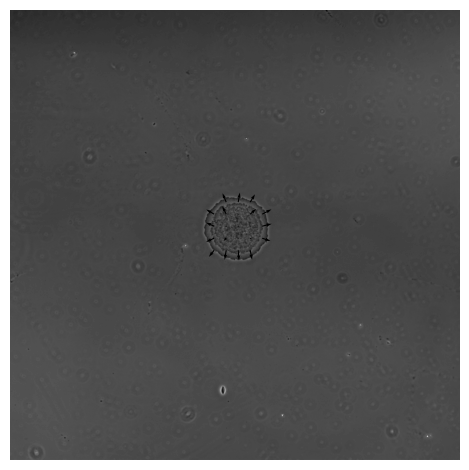

7


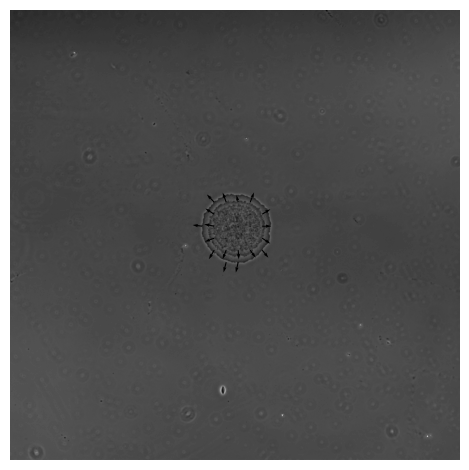

8


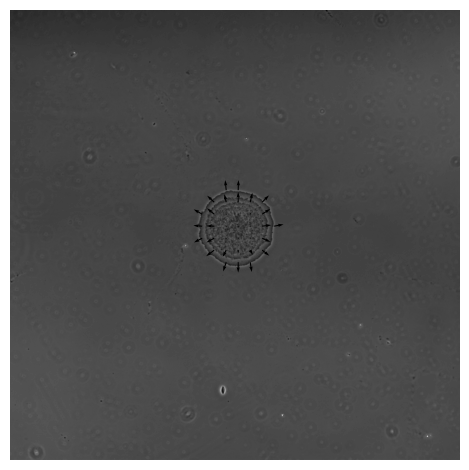

9


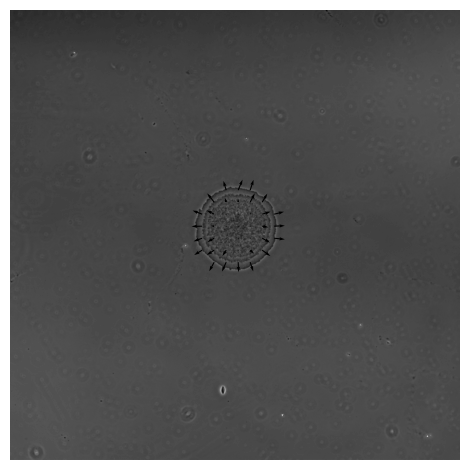

10


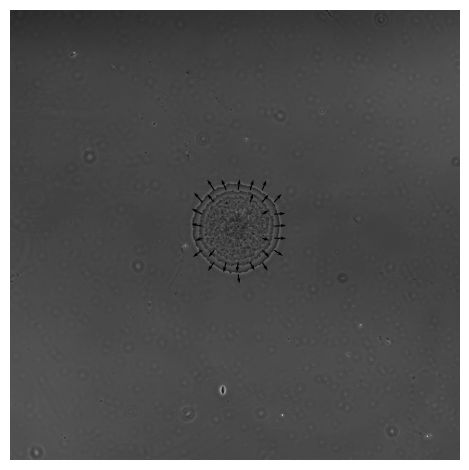

11


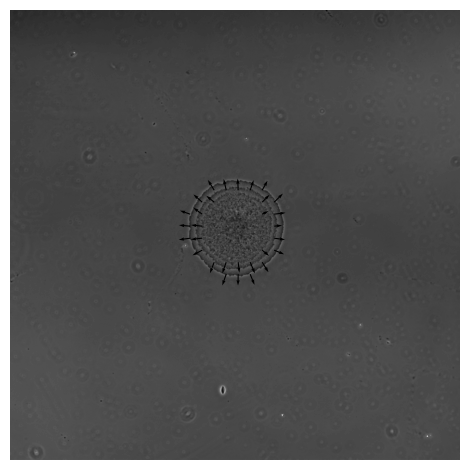

12


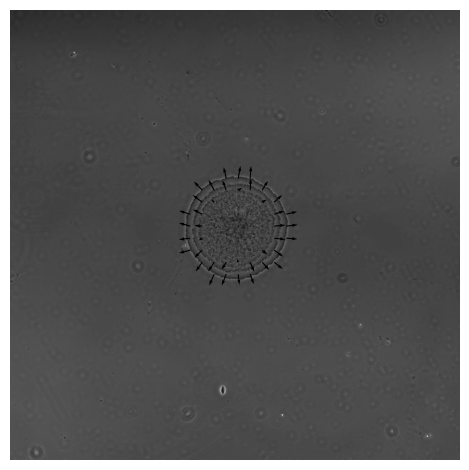

13


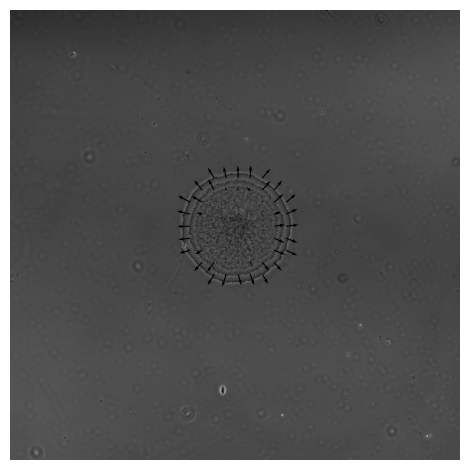

14


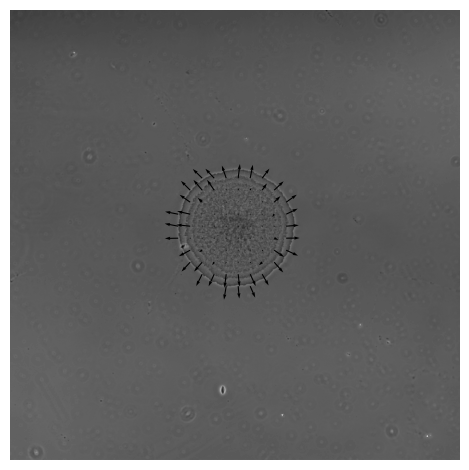

15


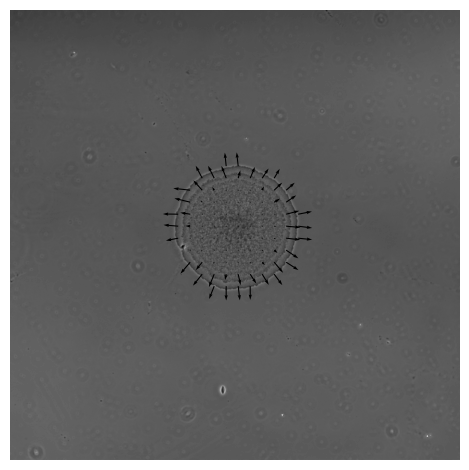

16


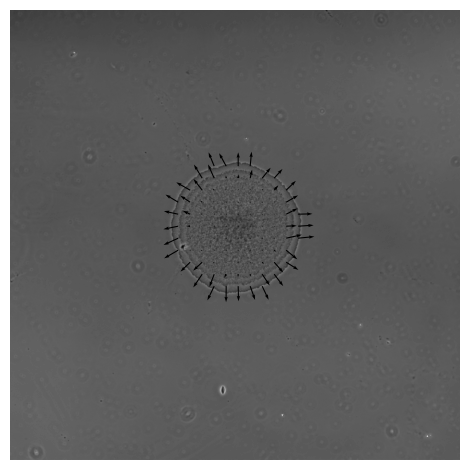

17


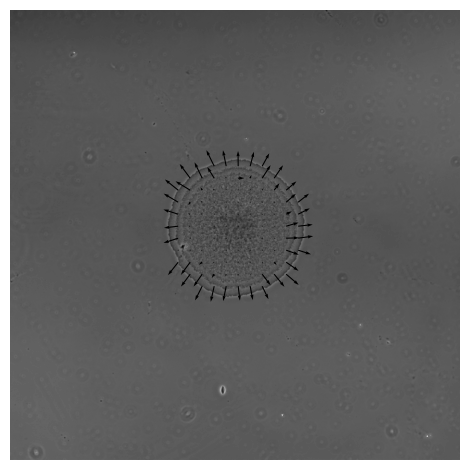

18


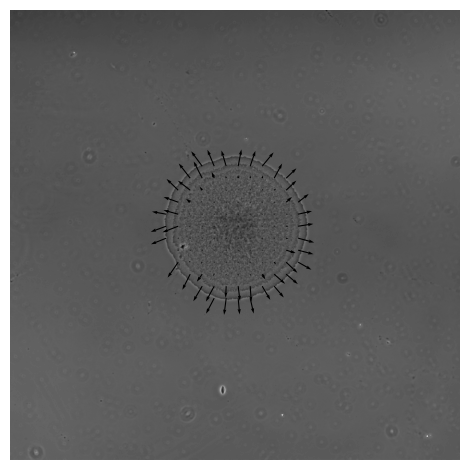

19


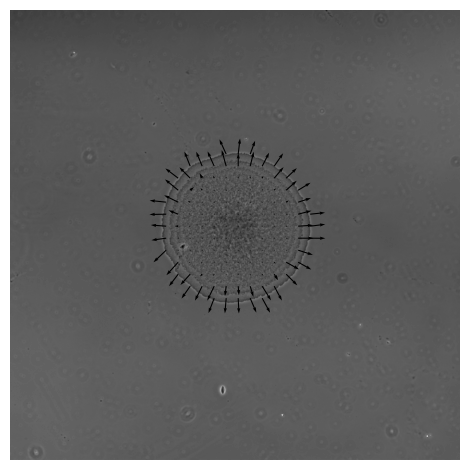

20


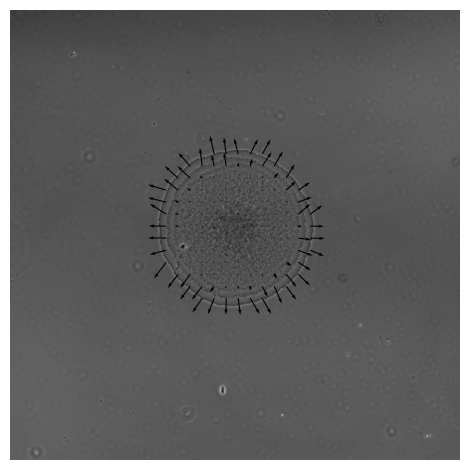

21


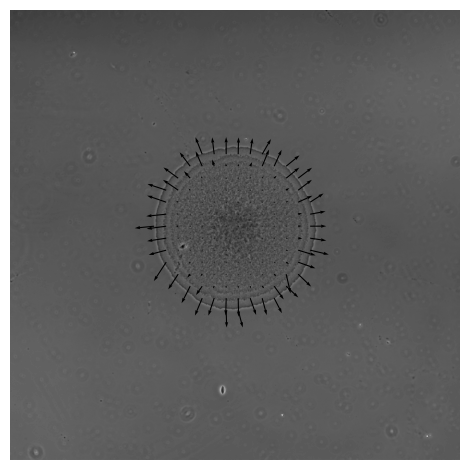

22


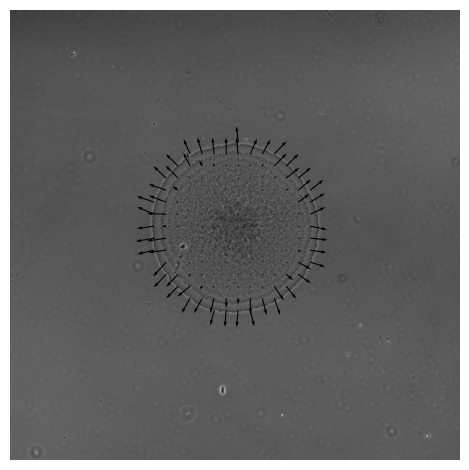

23


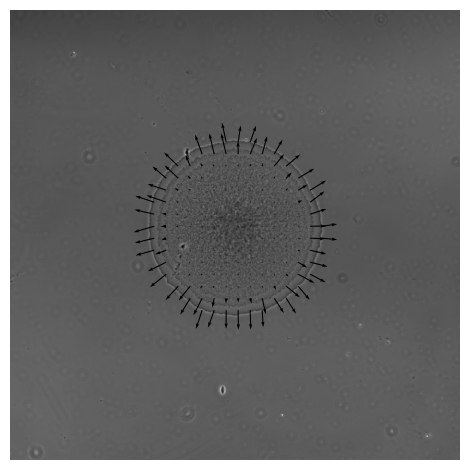

24


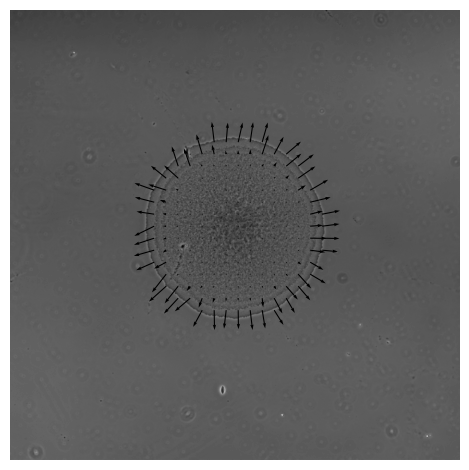

25


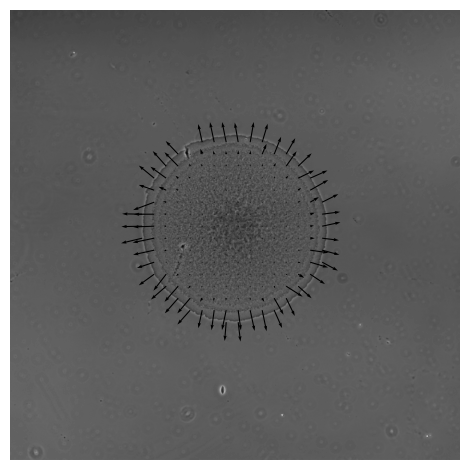

26


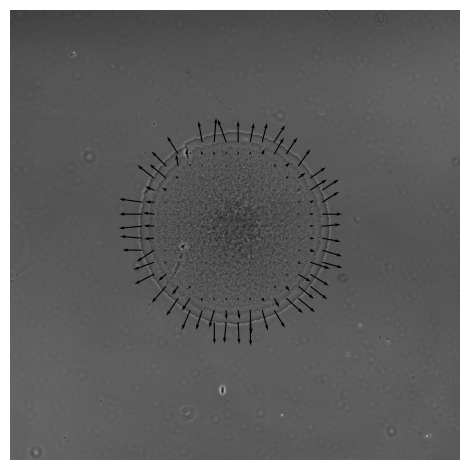

27


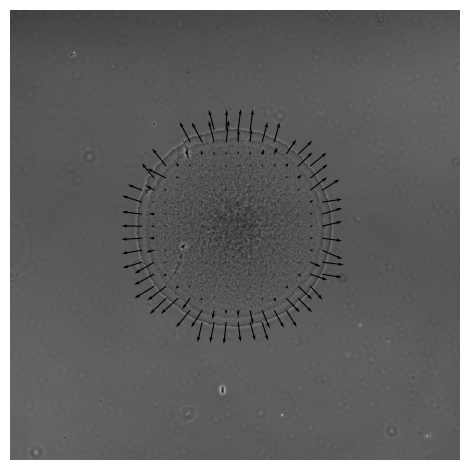

28


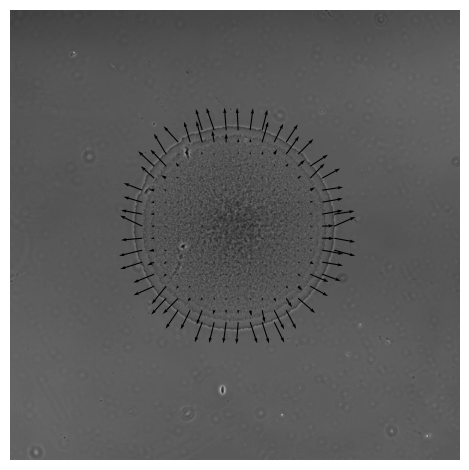

29


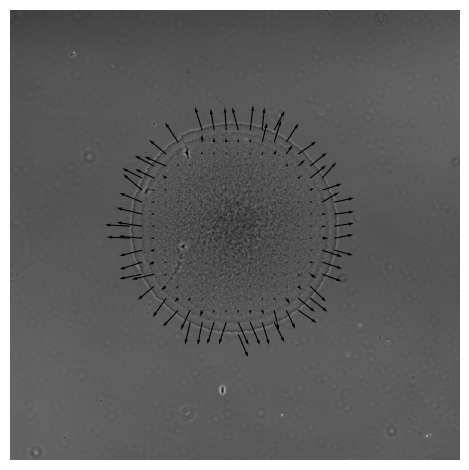

30


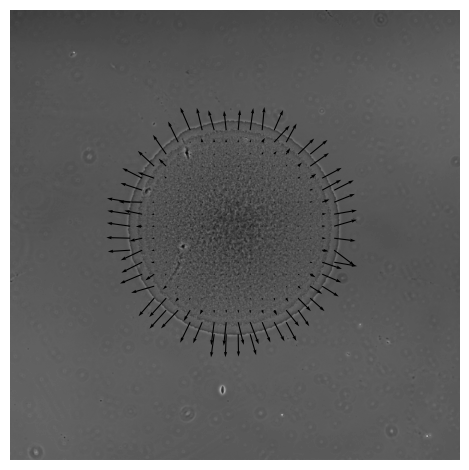

31


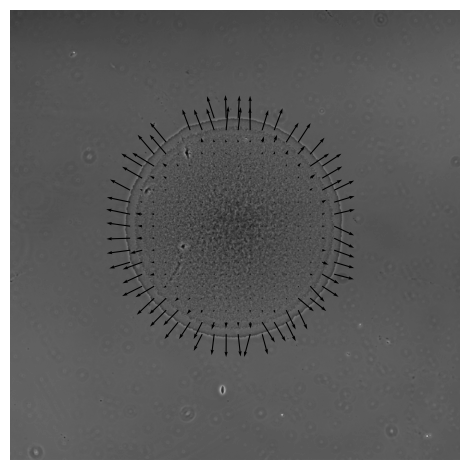

32


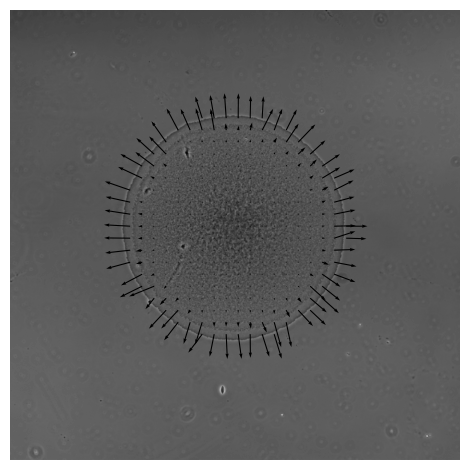

33


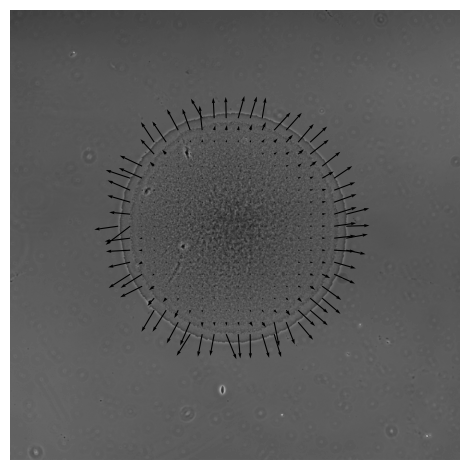

34


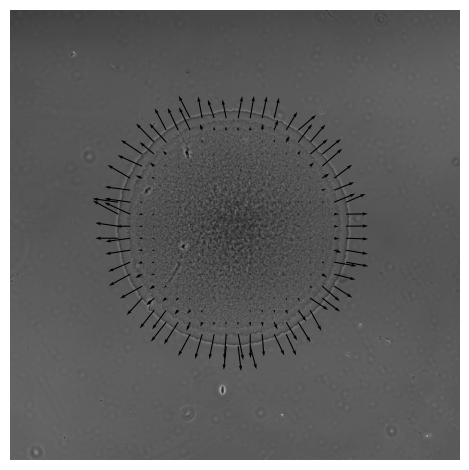

35


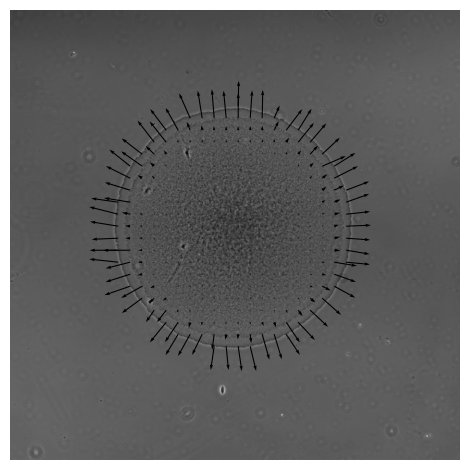

36


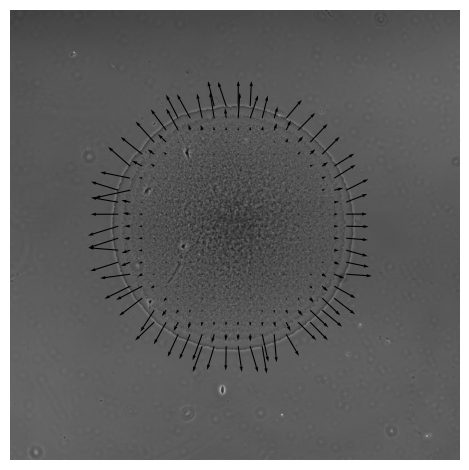

37


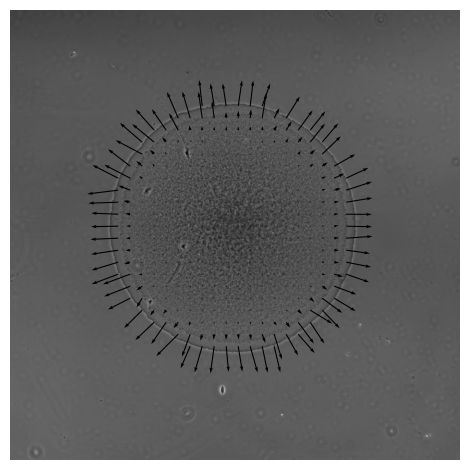

38


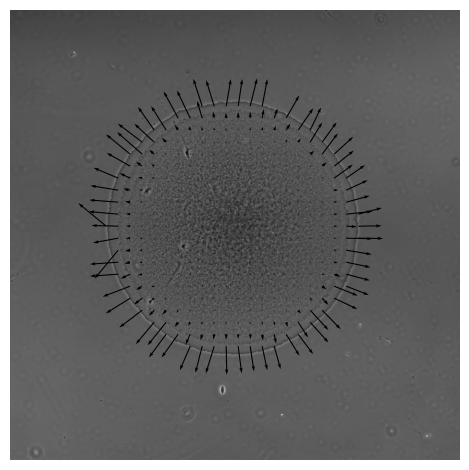

39


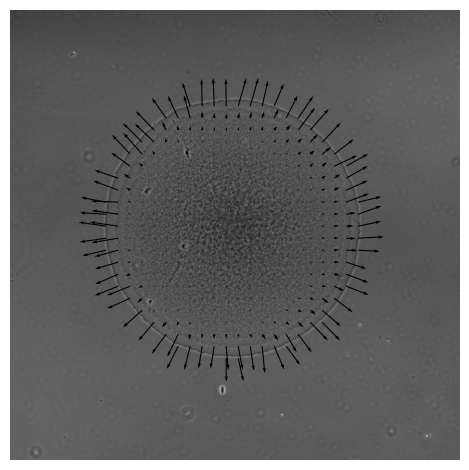

40


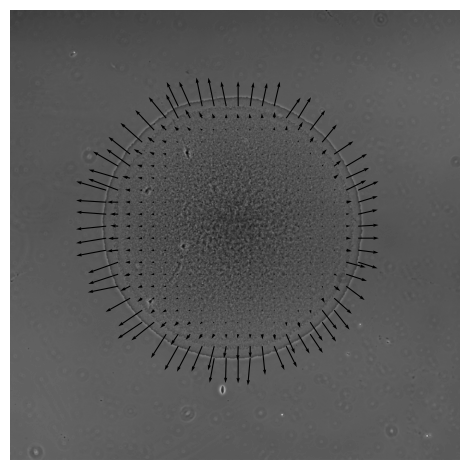

41


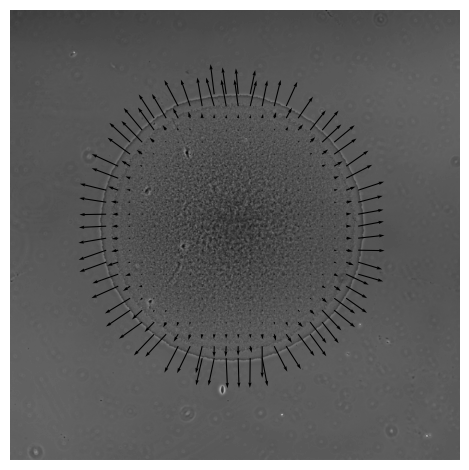

42


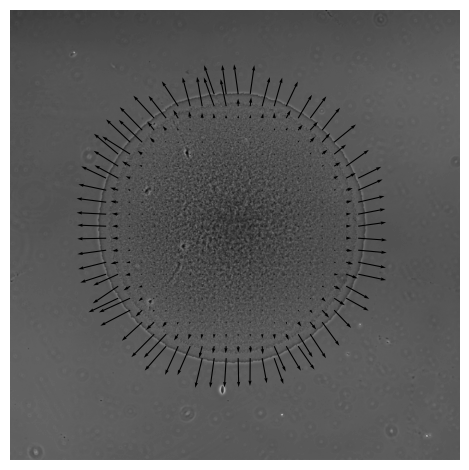

43


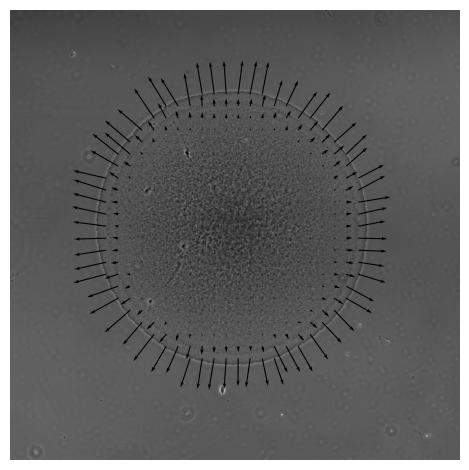

44


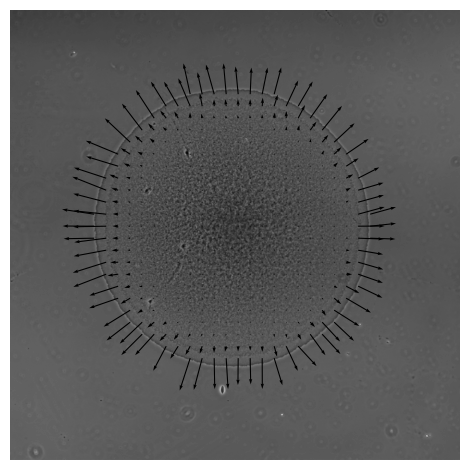

45


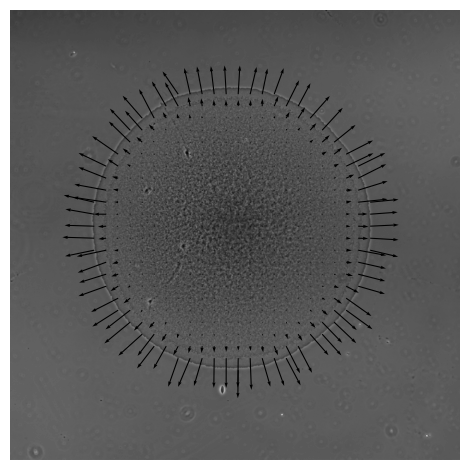

46


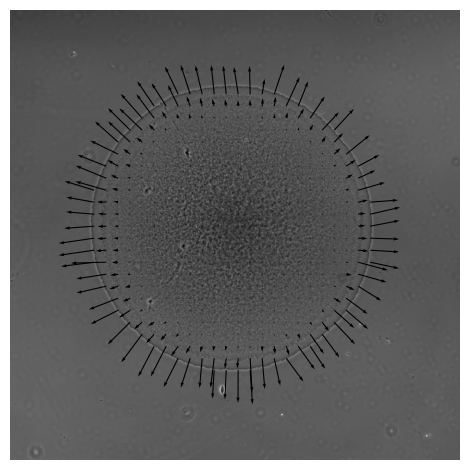

47


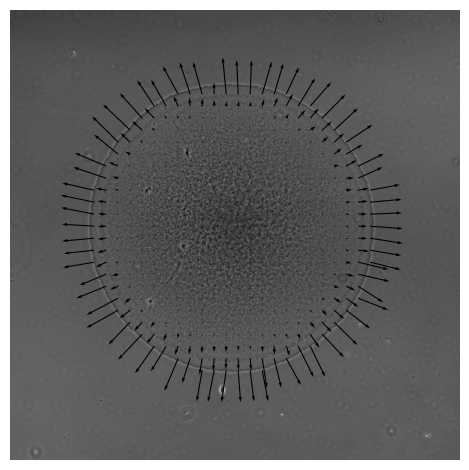

48


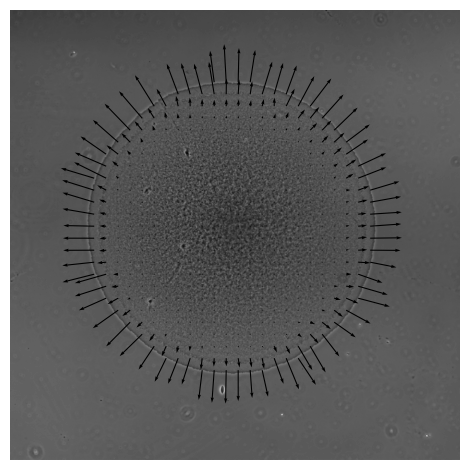

49


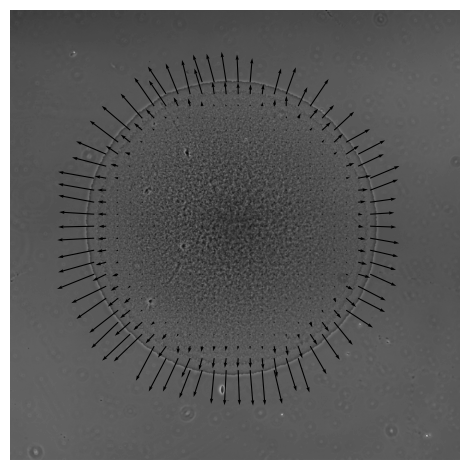

50


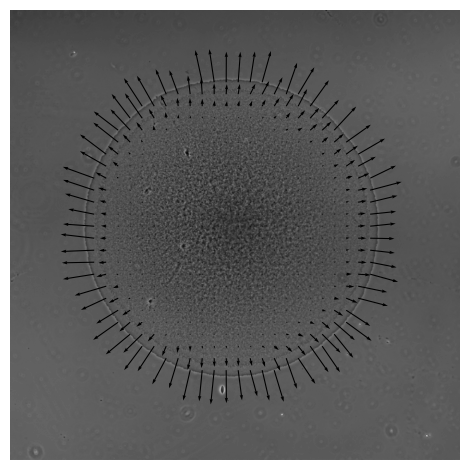

51


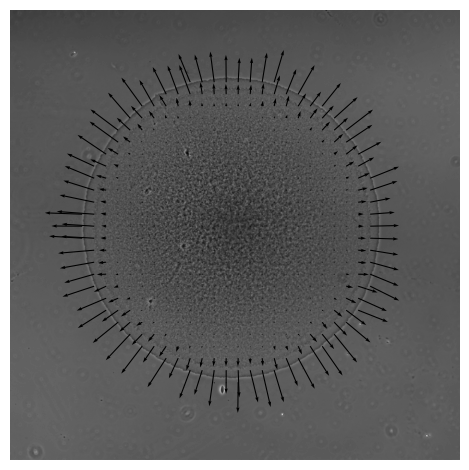

52


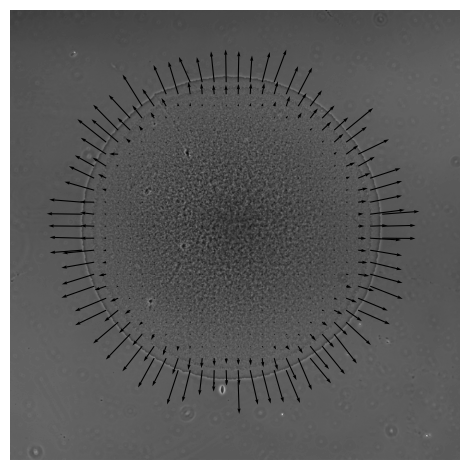

53


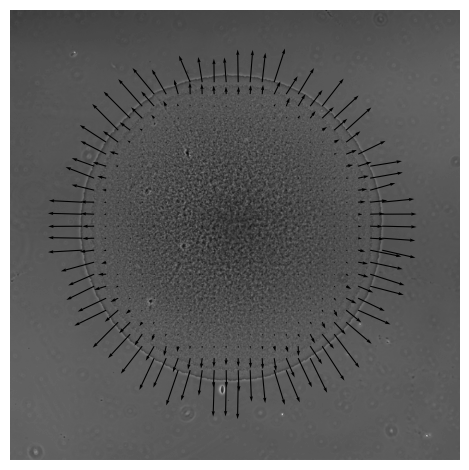

54


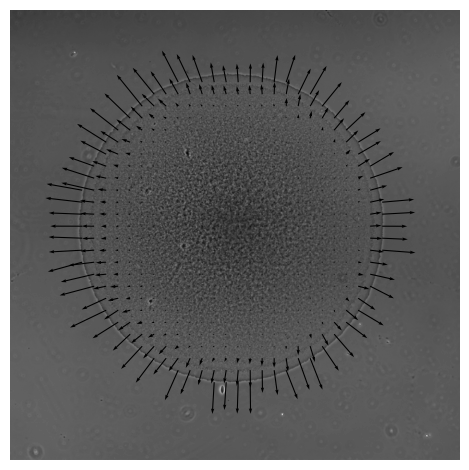

55


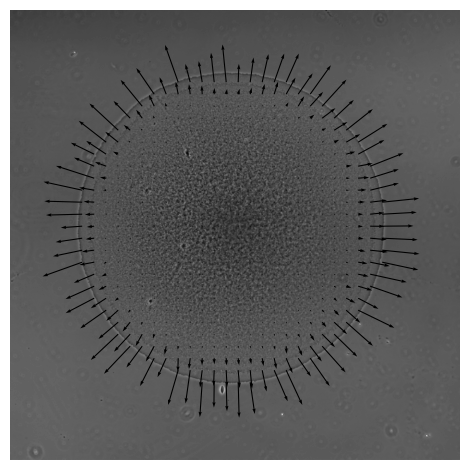

56


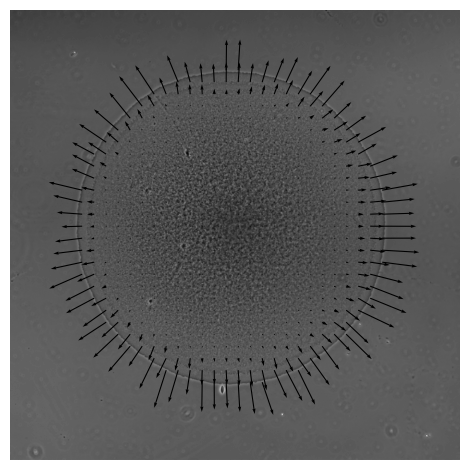

57


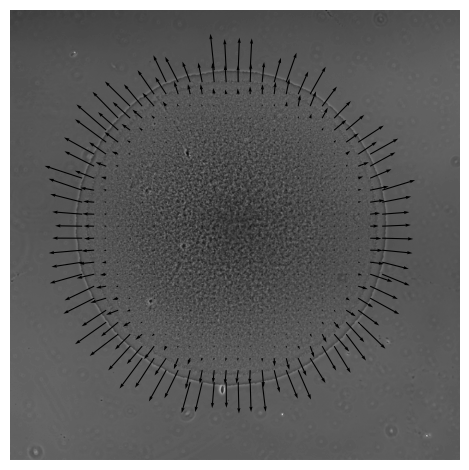

58


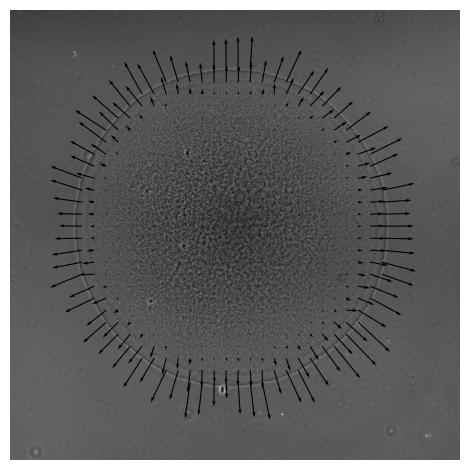

59


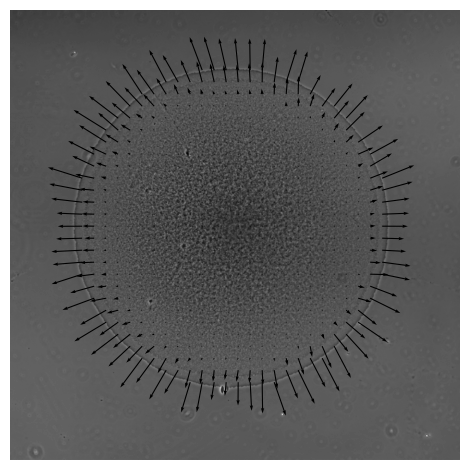

60


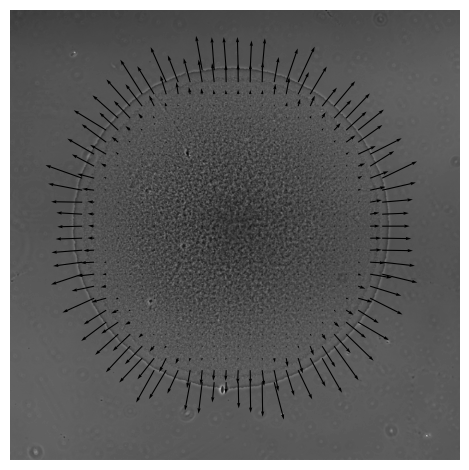

61


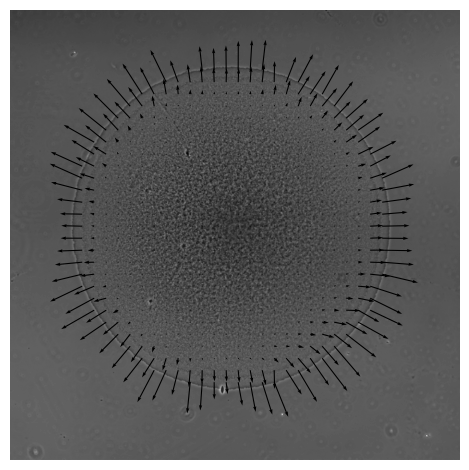

62


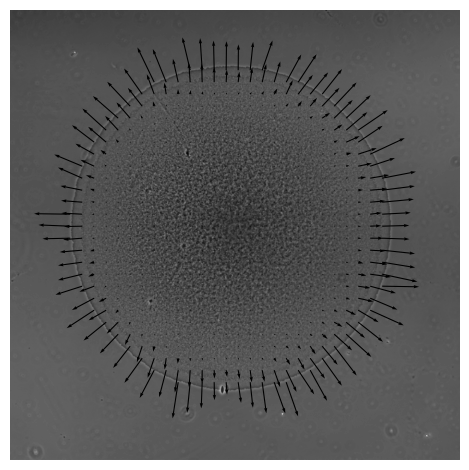

63


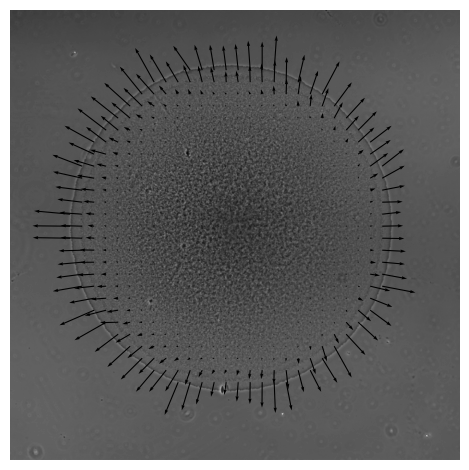

64


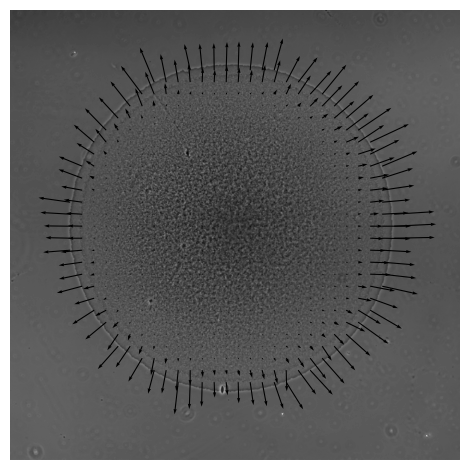

65


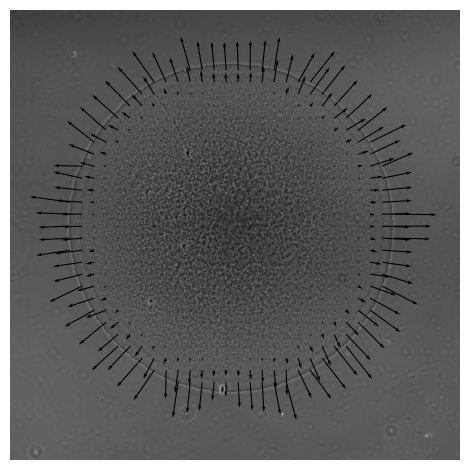

66


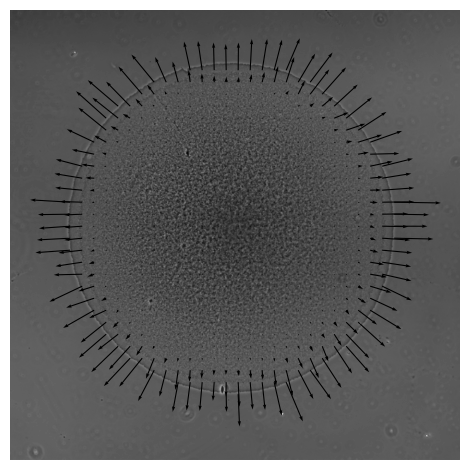

67


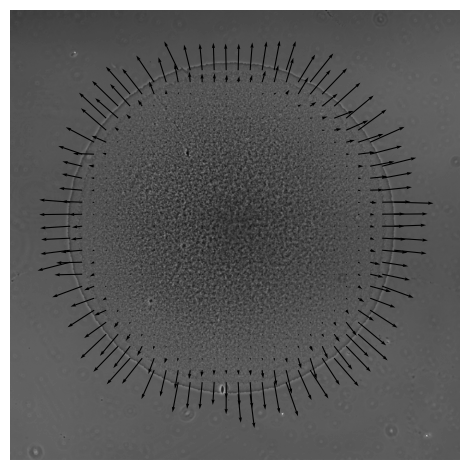

68


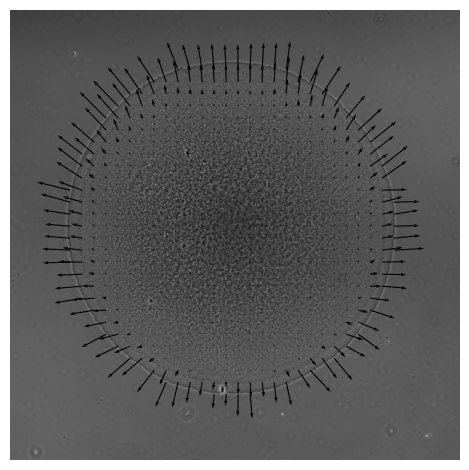

In [20]:
plot_quivers(im_all[:,:,:,ph_chn], pos, vel, 64, 64, tf=69)

In [34]:
tf = 69
images = im_all[:,:,:,ph_chn]
w, h = 64, 64
normed = False
#normed = True
max = np.nanmax(vel)

0


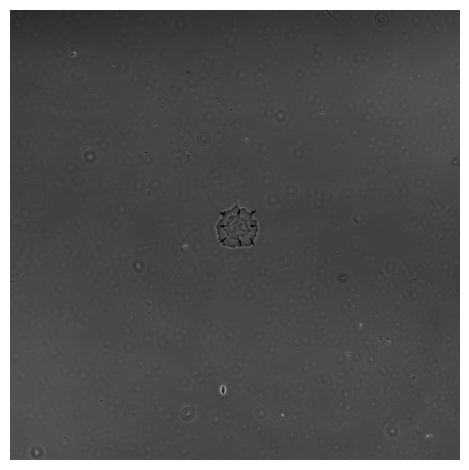

1


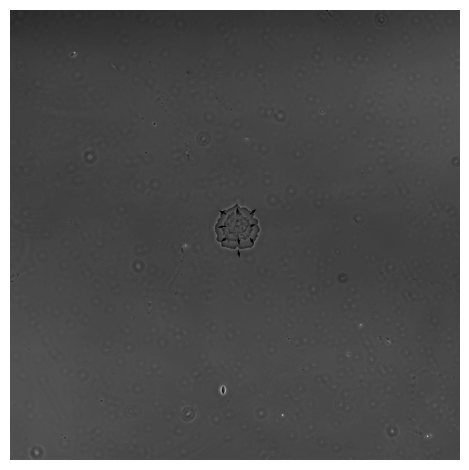

2


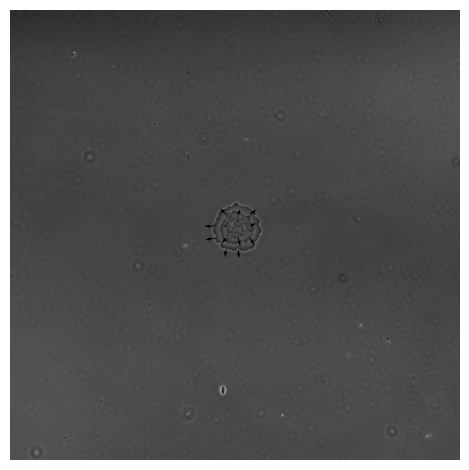

3


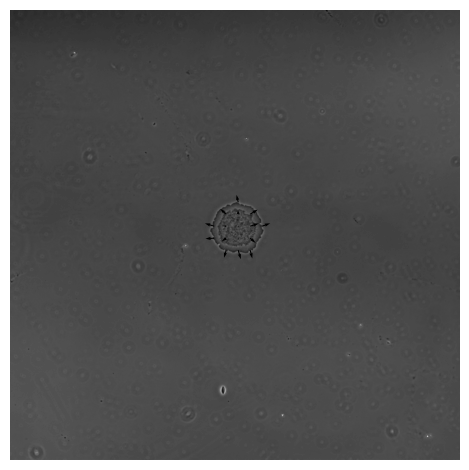

4


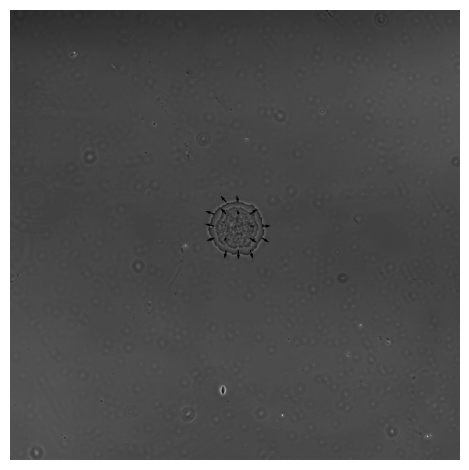

5


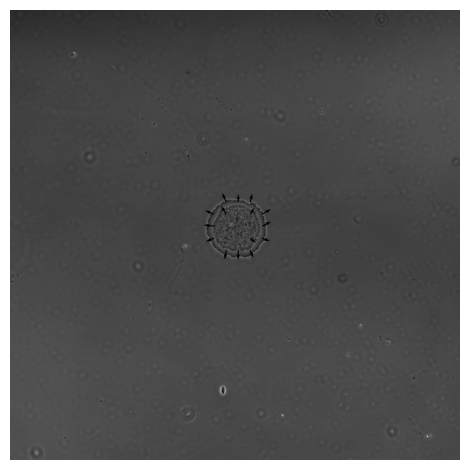

6


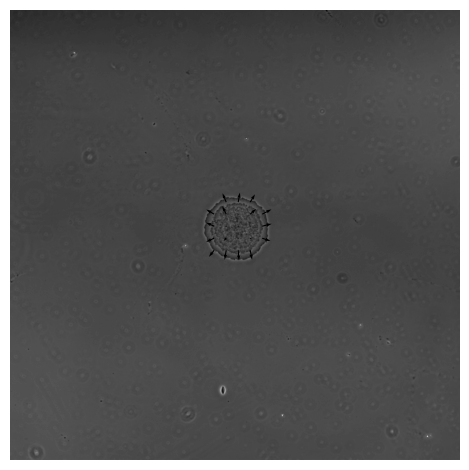

7


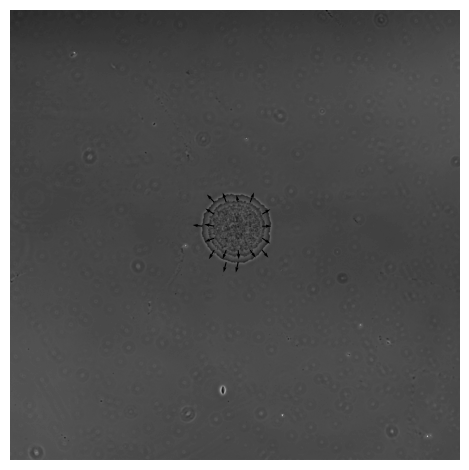

8


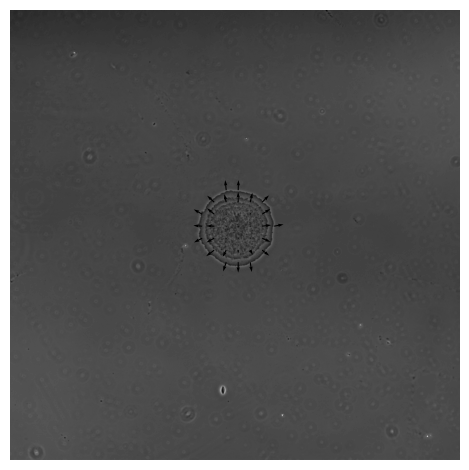

9


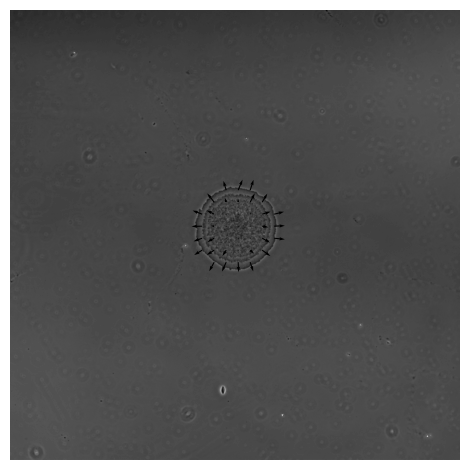

In [31]:
for t in range(tf):
    print(t)
    im = images[t]
    fig, ax = plt.subplots()
    #ax.imshow(im / np.max(im), cmap='gray')#, origin='upper', extent=[w, 0, h, 0])
    ax.imshow(im, cmap='gray')#, origin='upper', extent=[w, 0, h, 0])
    
    #plt.imshow(im/np.max(im),cmap='gray')#, origin='lower')
    if normed:
        norm = np.sqrt(vel[:,:,t,0]**2 + vel[:,:,t,1]**2)
    else:
        norm = 1
    vx = vel[:,:,t,0]
    vy = vel[:,:,t,1]


    #ax.quiver(w/2+pos[:,:,t,1],h/2+pos[:,:,t,0], vy/norm, -vx/norm,cmap='gray')
    ax.quiver(w/2+pos[:,:,t,1],h/2+pos[:,:,t,0], vy/max, -vx/max,cmap='gray')
    # Remove axis labels and ticks
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis('off')        
    plt.tight_layout()
    plt.savefig(f'Quivers/quiver_{t}.png', bbox_inches='tight', pad_inches=0, dpi=300)
    plt.show()

0


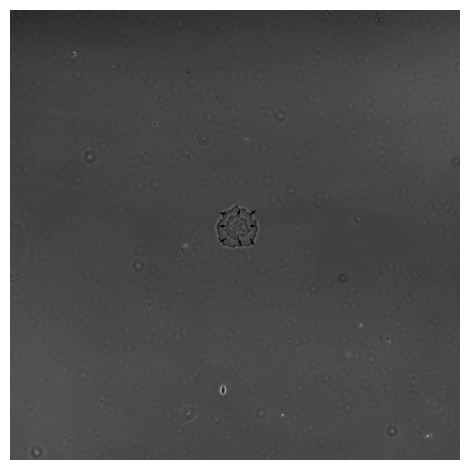

1


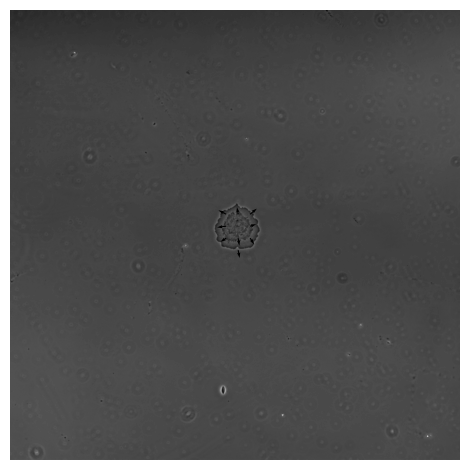

2


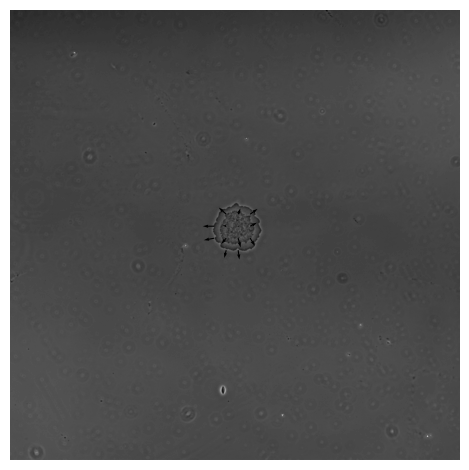

3


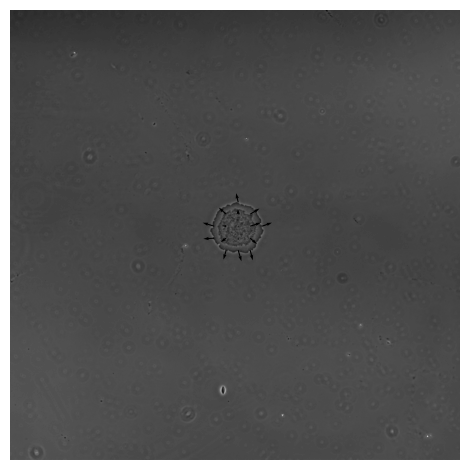

4


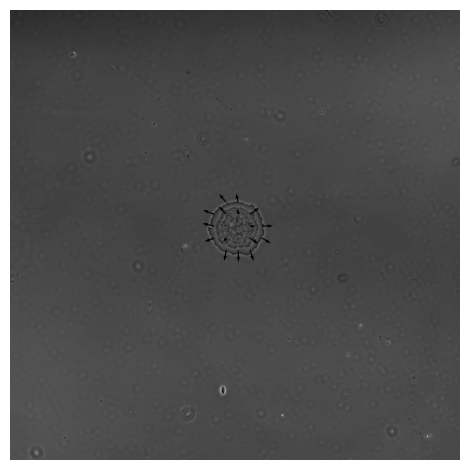

5


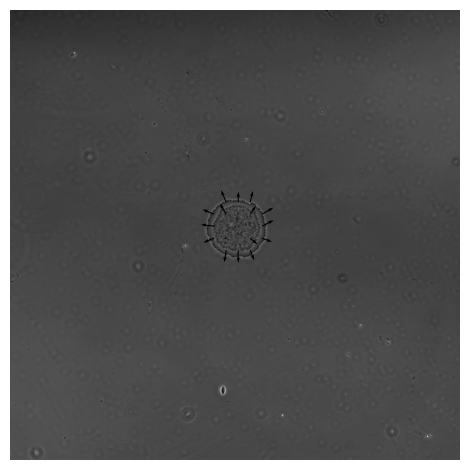

6


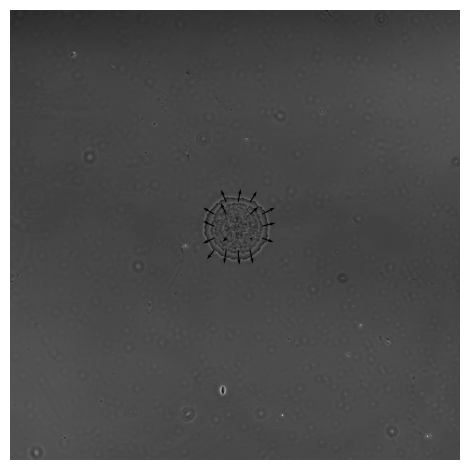

7


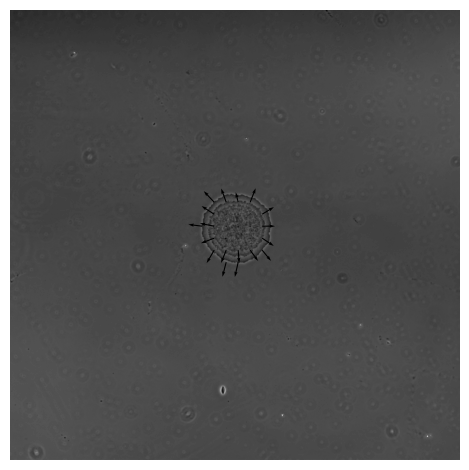

8


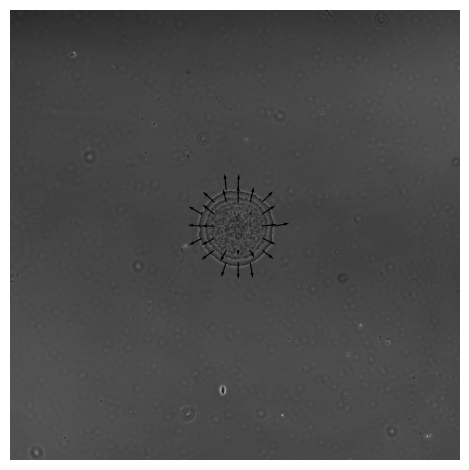

9


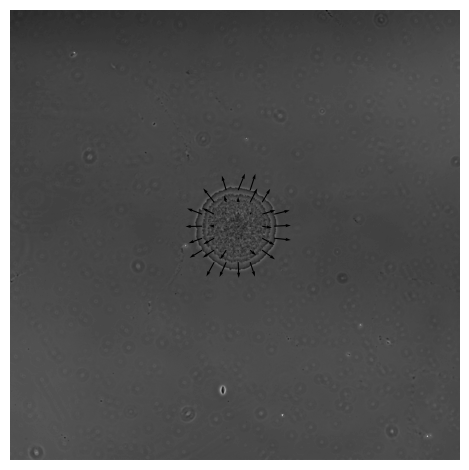

10


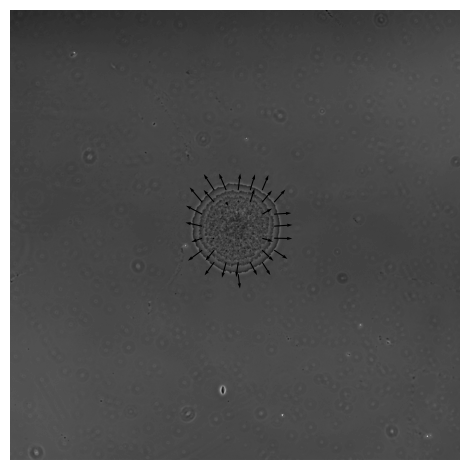

11


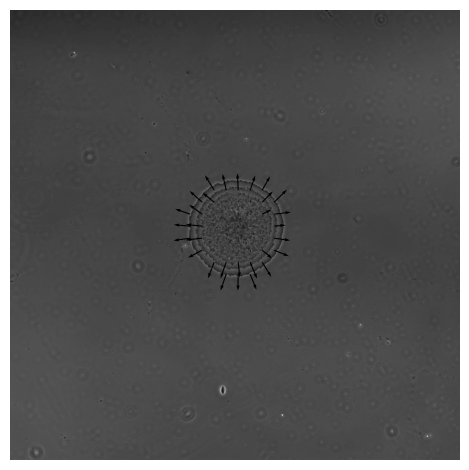

12


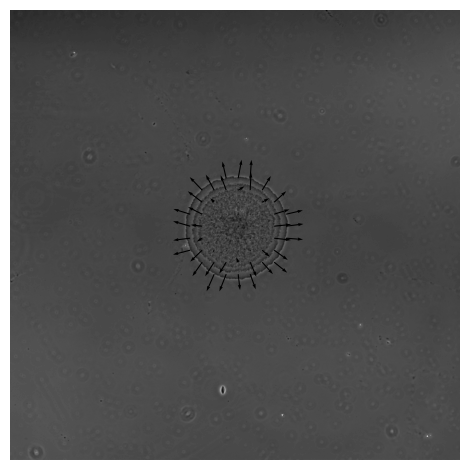

13


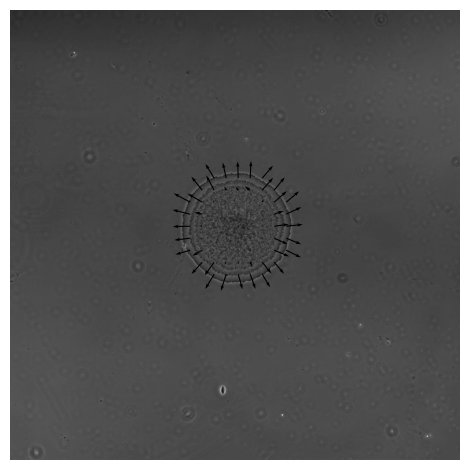

14


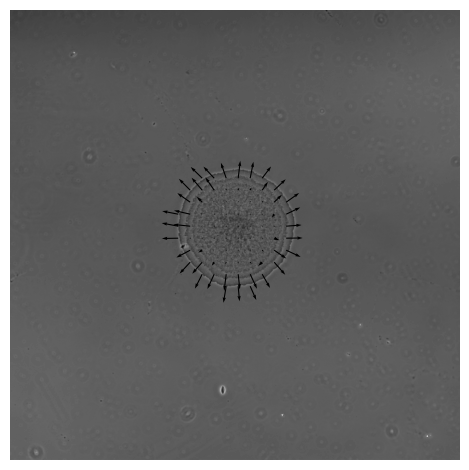

15


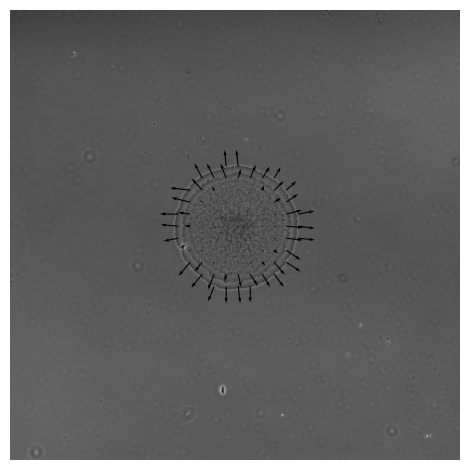

16


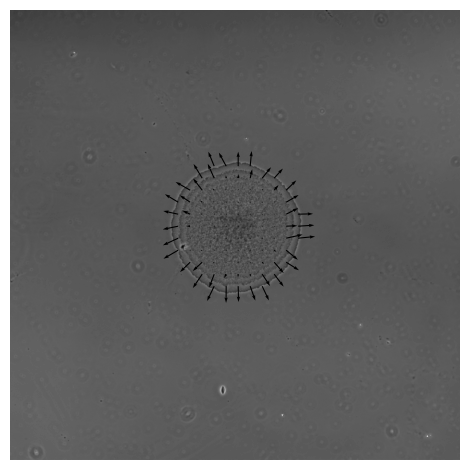

17


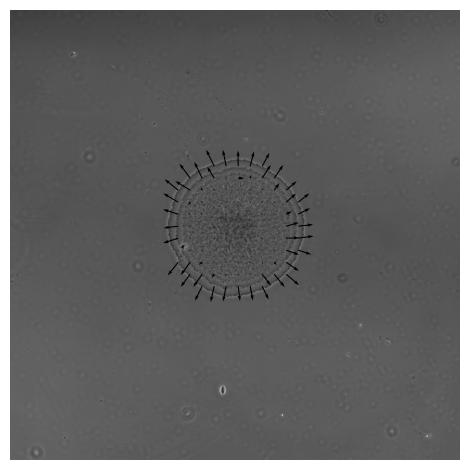

18


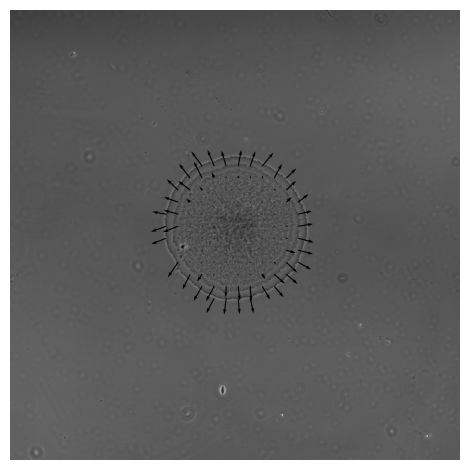

19


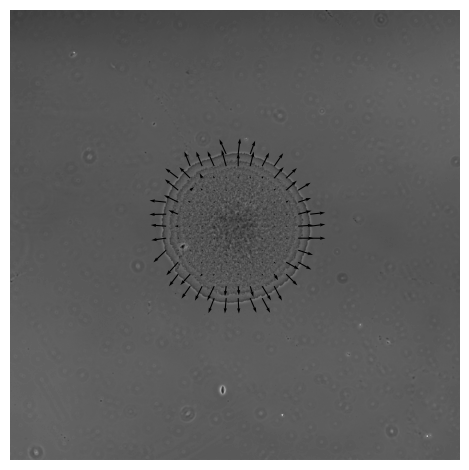

20


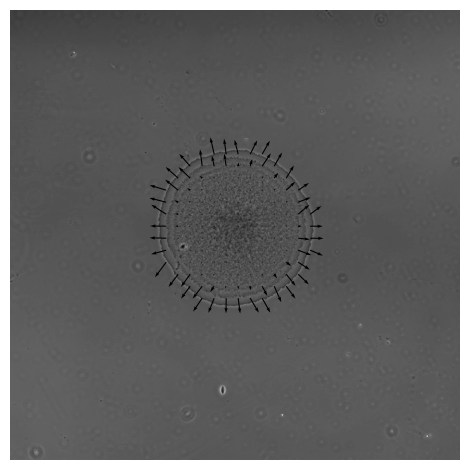

21


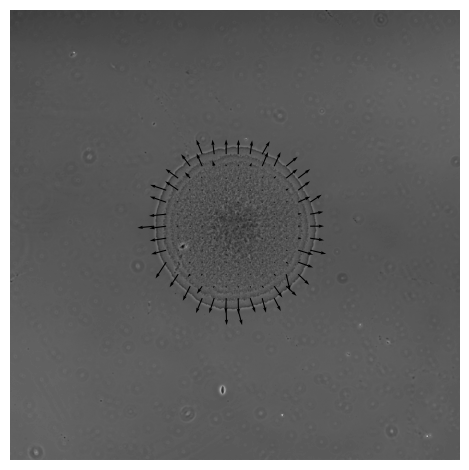

22


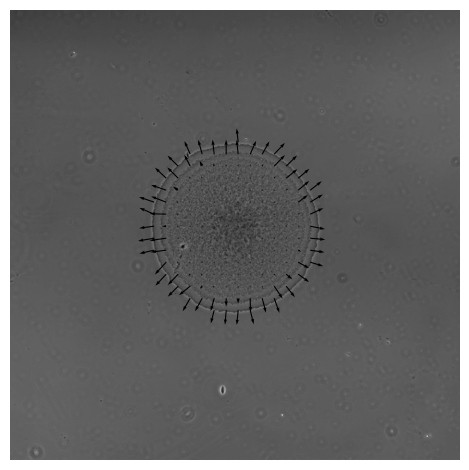

23


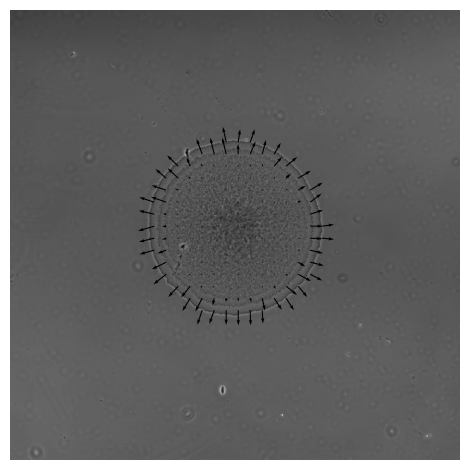

24


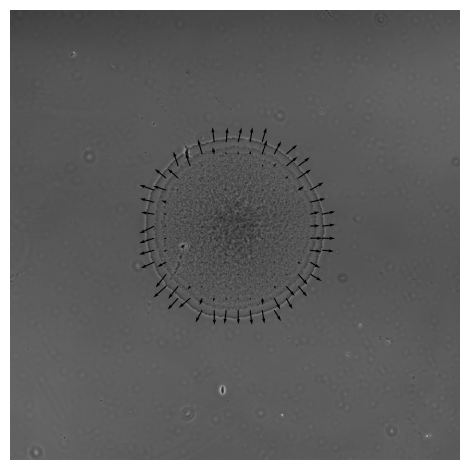

25


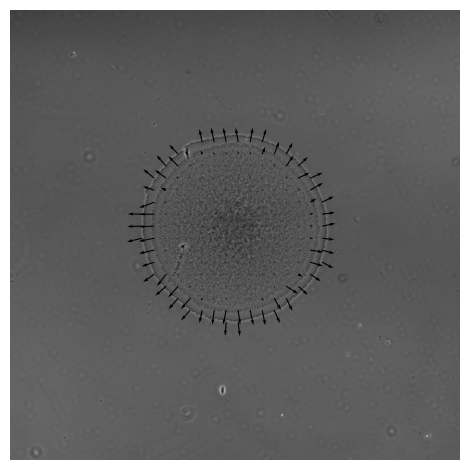

26


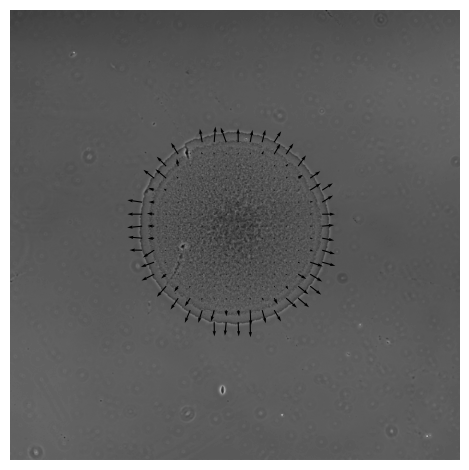

27


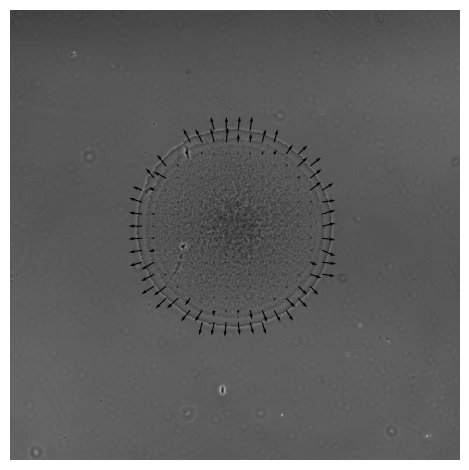

28


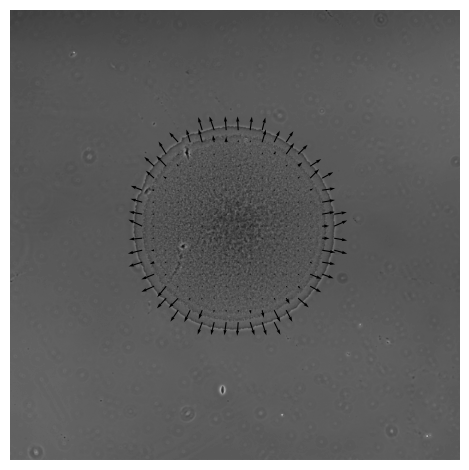

29


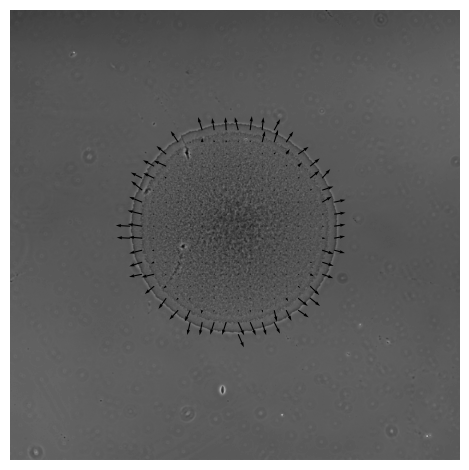

30


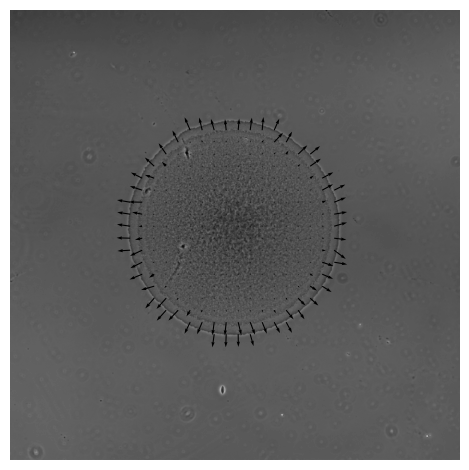

31


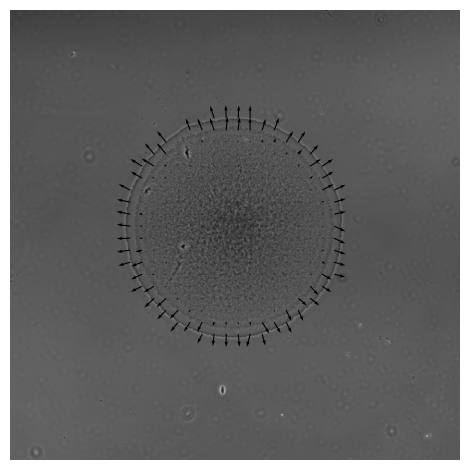

32


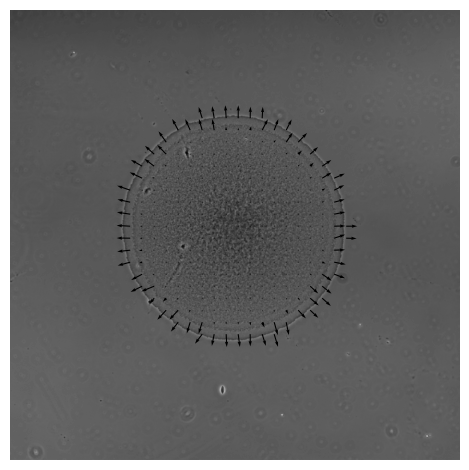

33


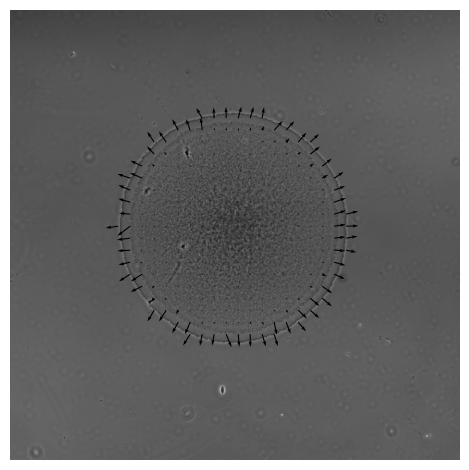

34


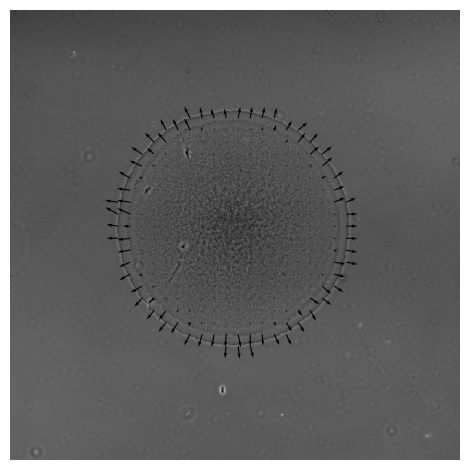

35


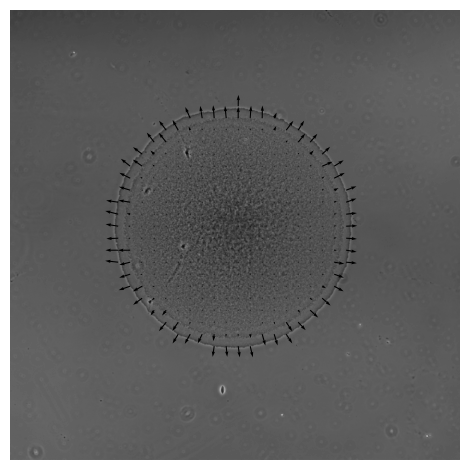

36


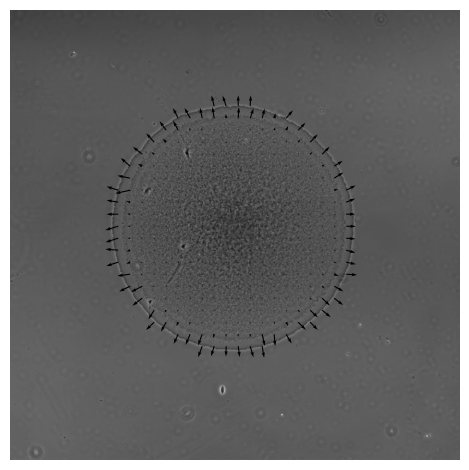

37


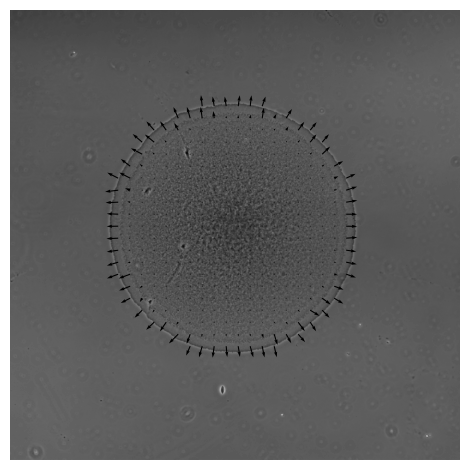

38


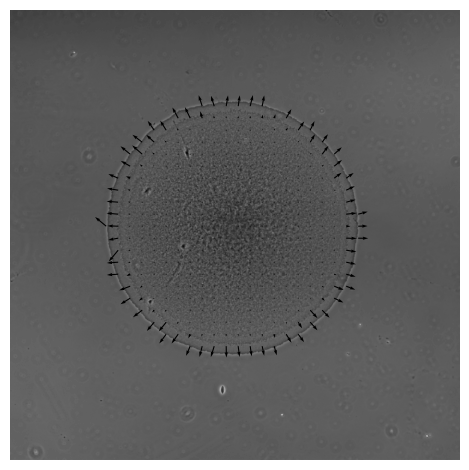

39


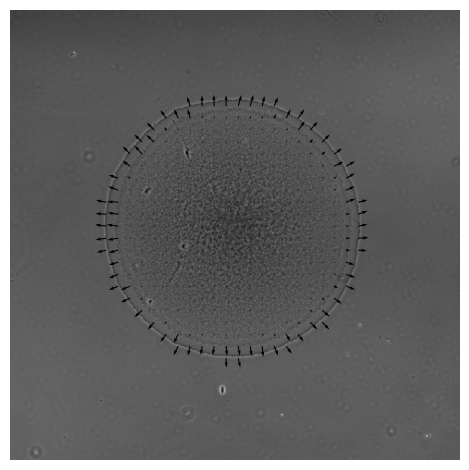

40


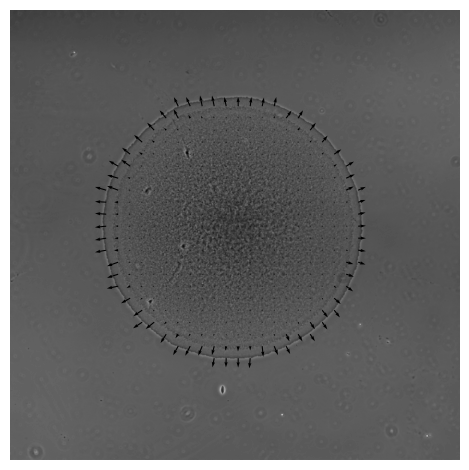

41


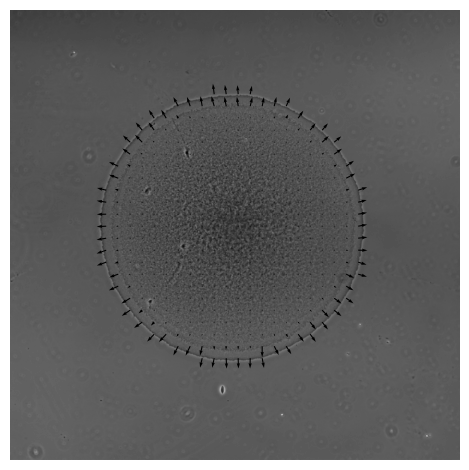

42


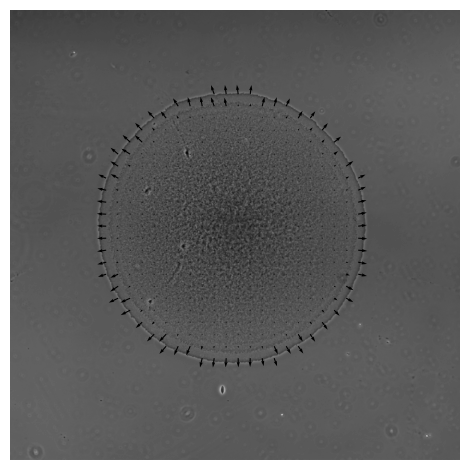

43


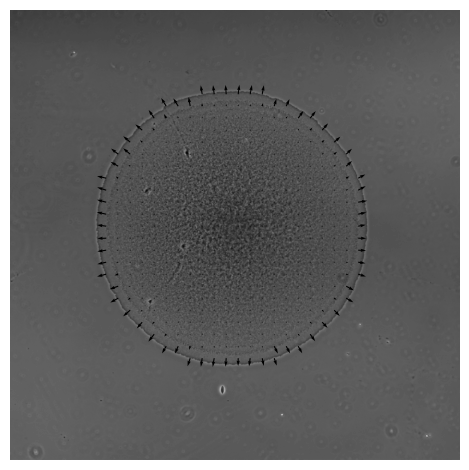

44


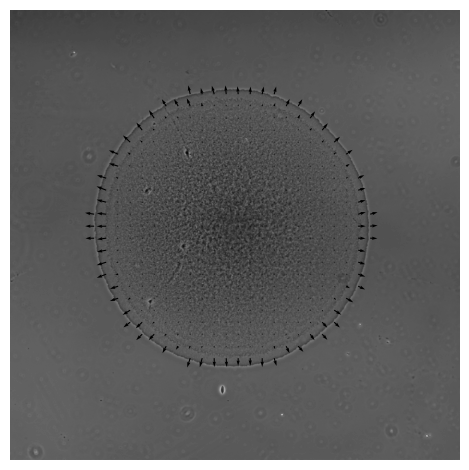

45


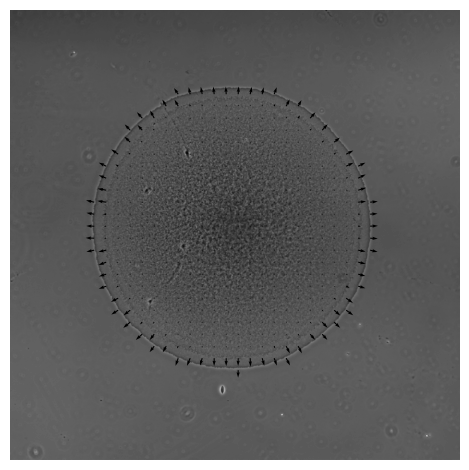

46


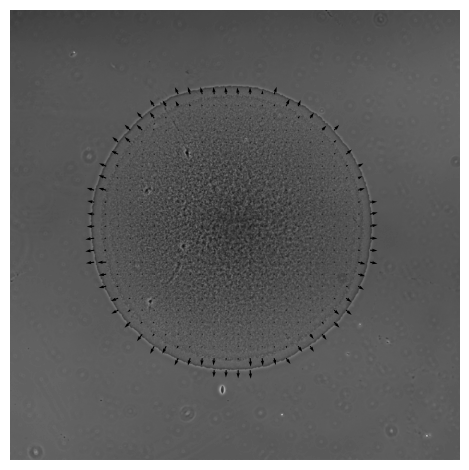

47


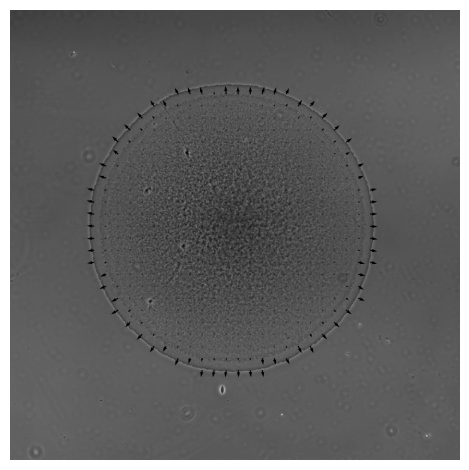

48


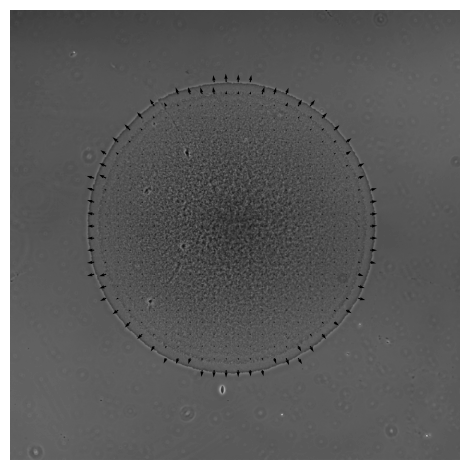

49


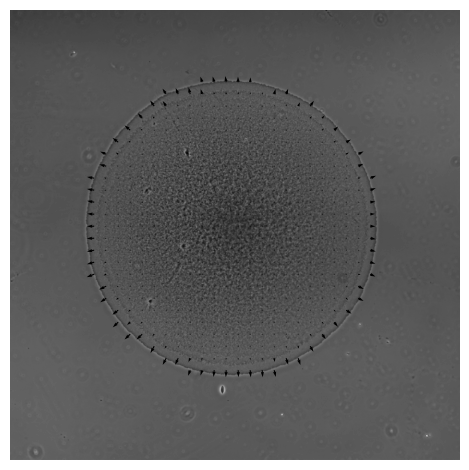

50


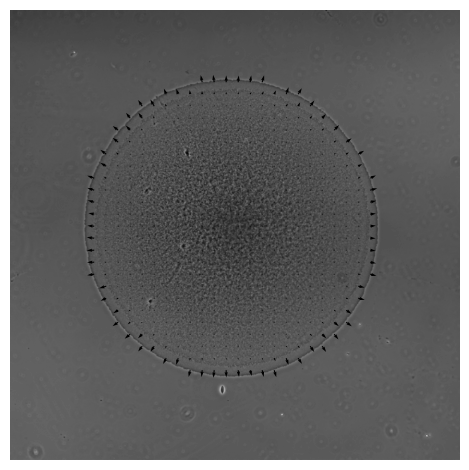

51


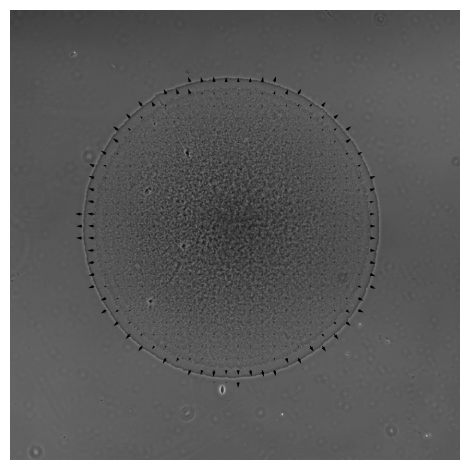

52


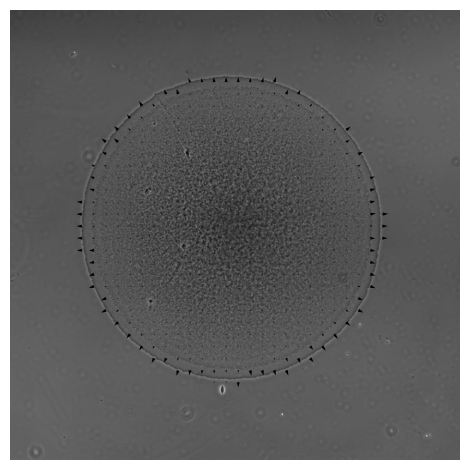

53


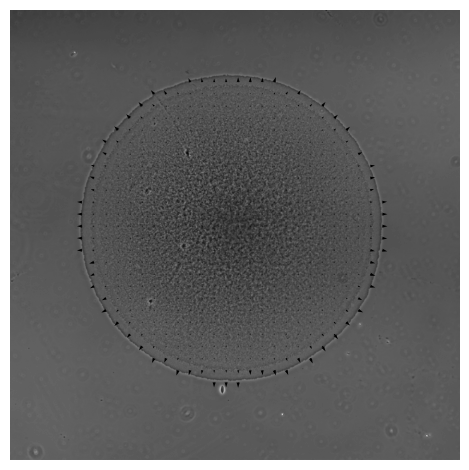

54


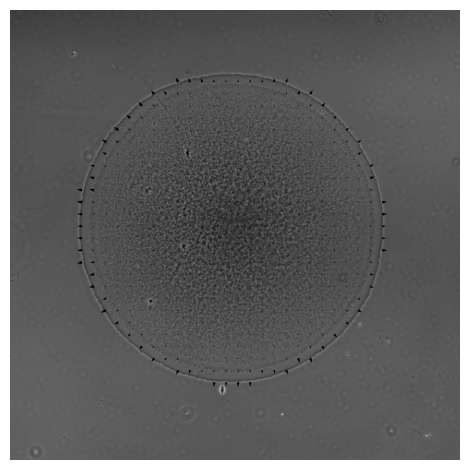

55


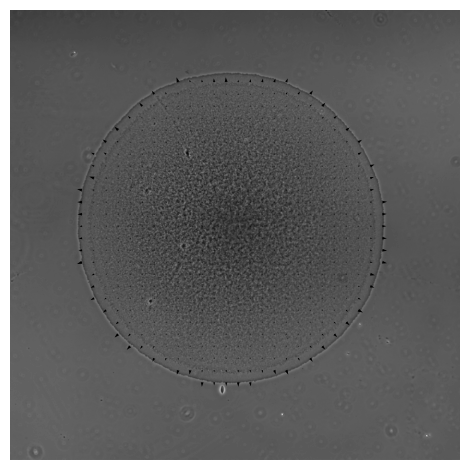

56


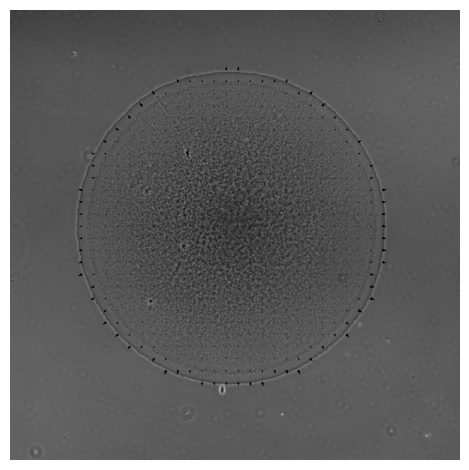

57


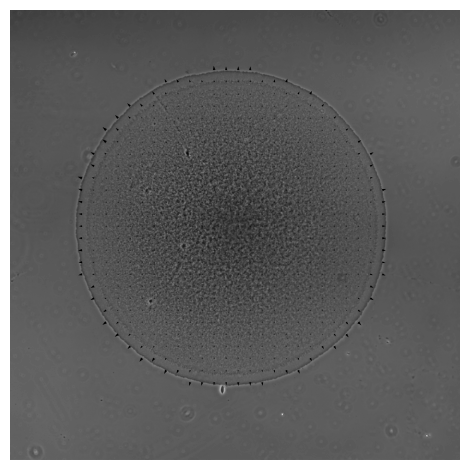

58


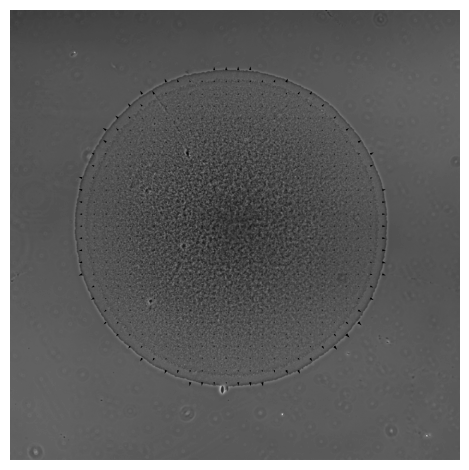

59


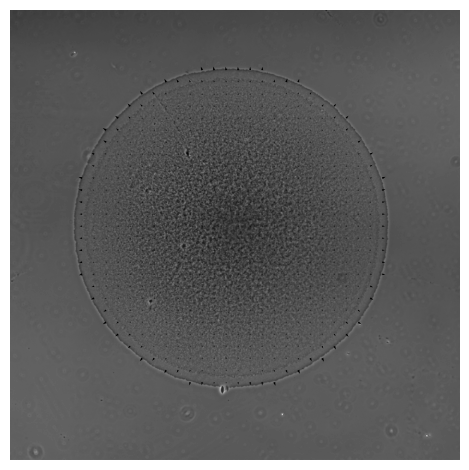

60


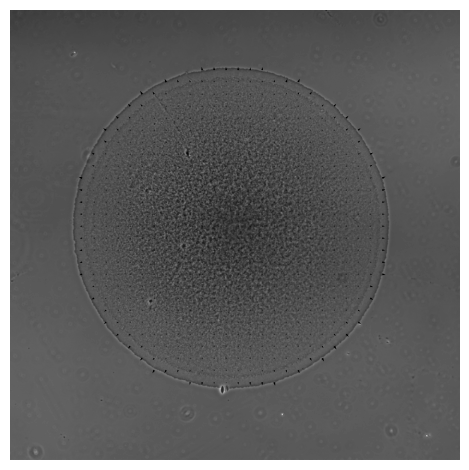

61


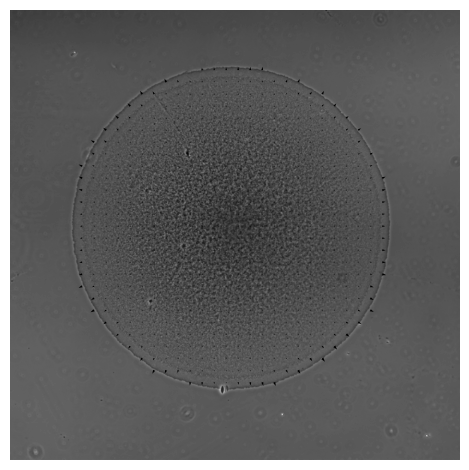

62


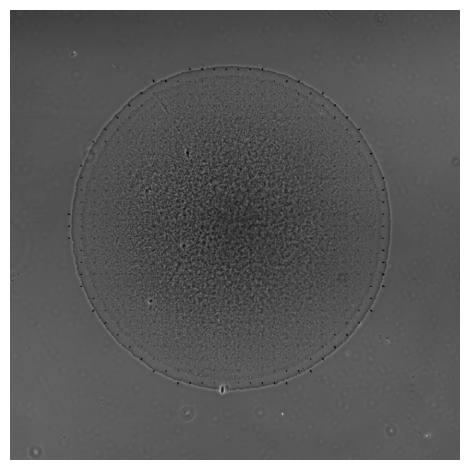

63


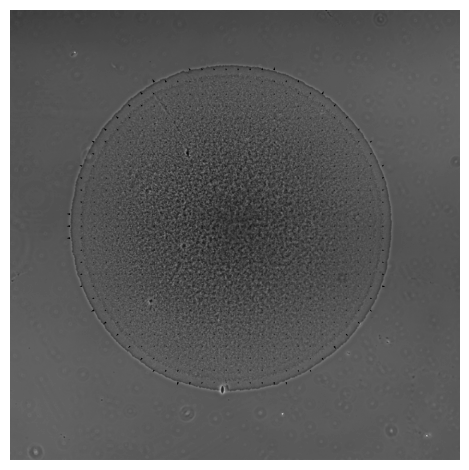

64


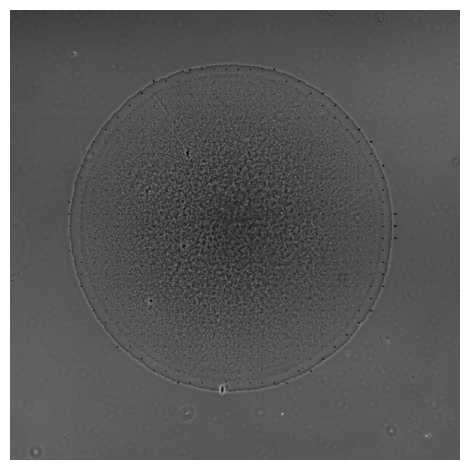

65


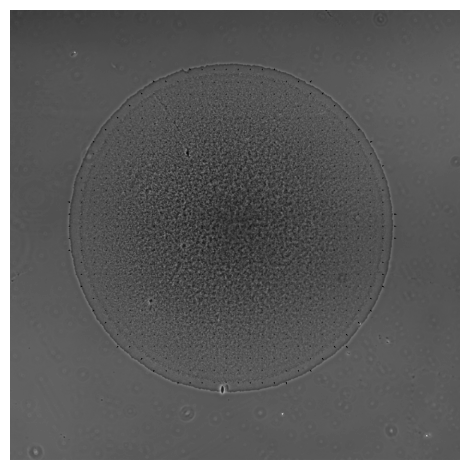

66


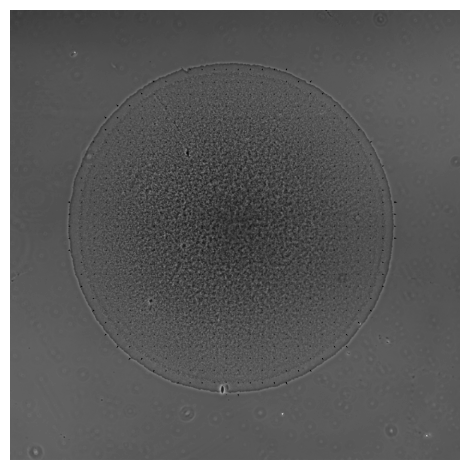

67


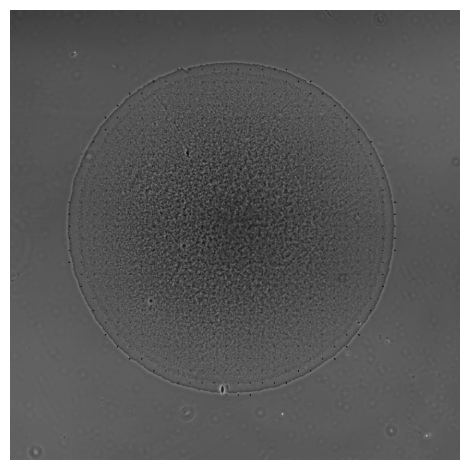

68


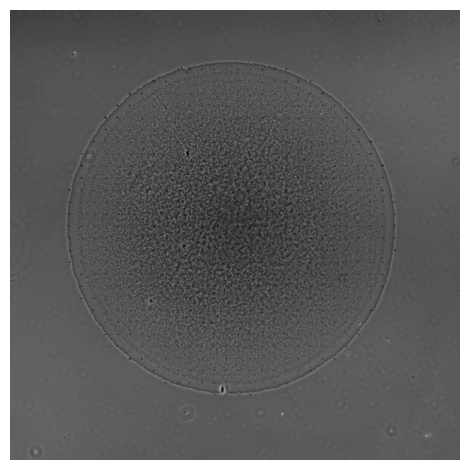

In [39]:
scale = 0.2  # 1 means 1 unit of velocity corresponds to 1 pixel of arrow length
scale_units = 'xy'  # interpret scale in data units (i.e., pixel coordinates)

for t in range(tf):
    print(t)
    im = images[t]
    fig, ax = plt.subplots()
    ax.imshow(im, cmap='gray')

    vx = vel[:,:,t,0]
    vy = vel[:,:,t,1]

    ax.quiver(
        w/2 + pos[:,:,t,1],  # x positions
        h/2 + pos[:,:,t,0],  # y positions
        vy, -vx,             # U, V components (careful with the sign!)
        scale=scale,
        scale_units='xy',
        color='black'        # use a fixed color so cmap doesn't change over time
    )

    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis('off')        
    plt.tight_layout()
    plt.savefig(f'Quivers/quiver_{t}.png', bbox_inches='tight', pad_inches=0, dpi=300)
    plt.show()


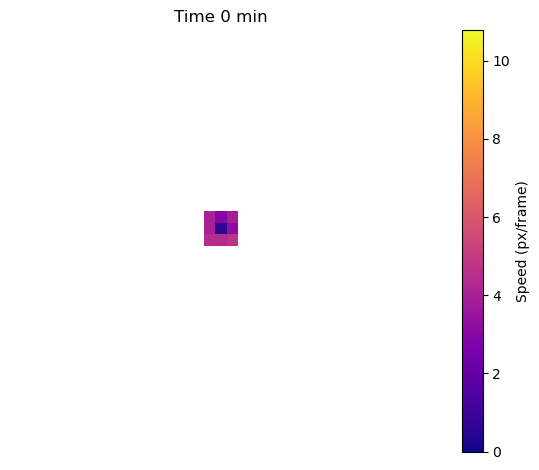

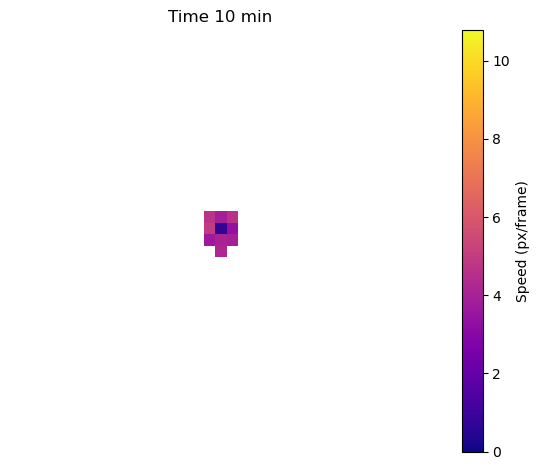

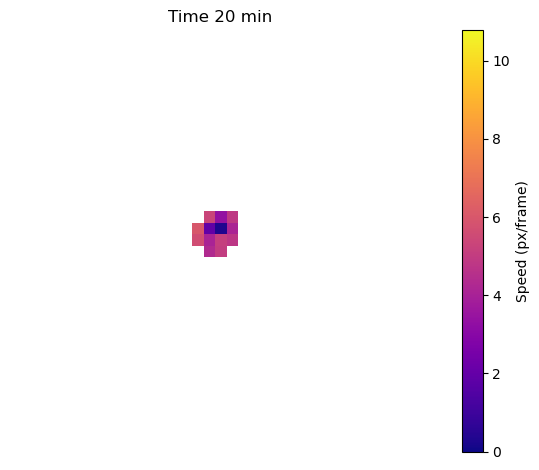

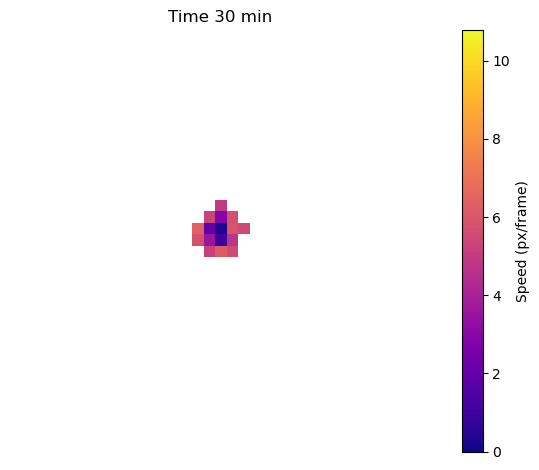

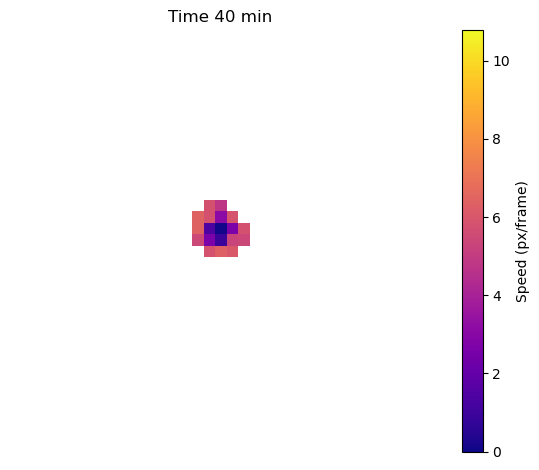

...

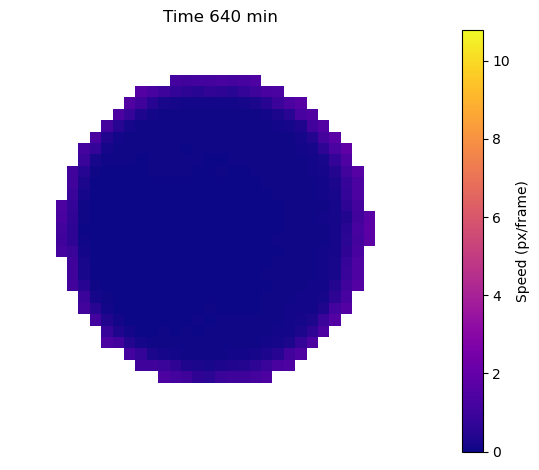

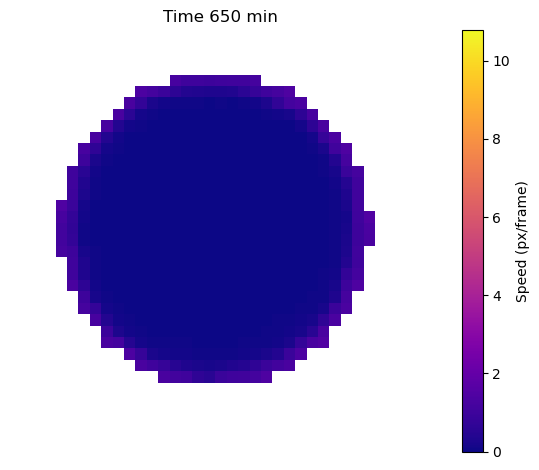

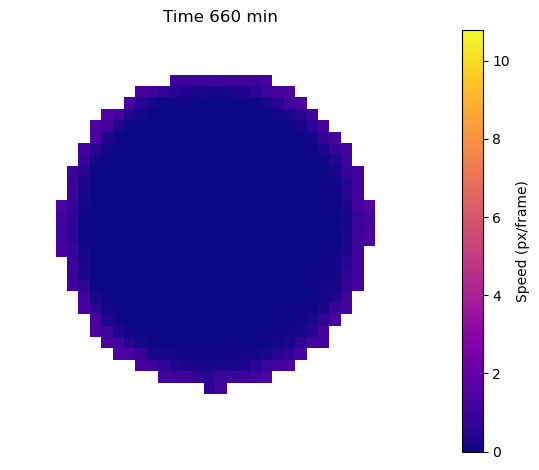

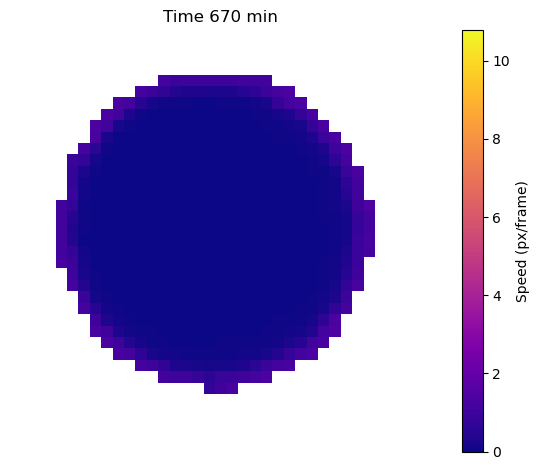

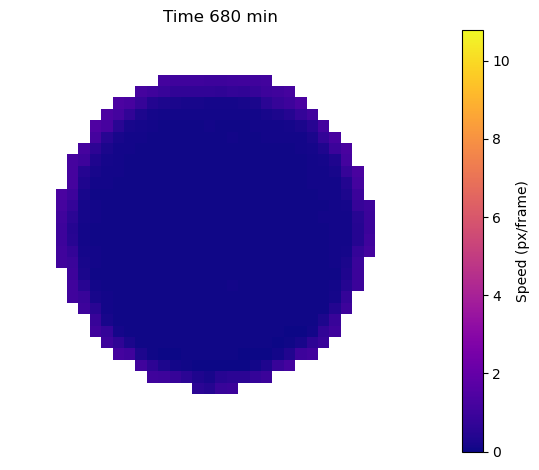

In [41]:
speed = np.linalg.norm(vel, axis=3)

for t in range(tf):  # choose key timepoints
    fig, ax = plt.subplots()
    im = ax.imshow(speed[:,:,t], cmap='plasma', vmin=0, vmax=np.nanmax(speed))
    ax.set_title(f'Time {t*10} min')  # if frame interval is 10 min
    ax.axis('off')
    plt.colorbar(im, ax=ax, label='Speed (px/frame)')
    plt.tight_layout()
    plt.savefig(f'Heatmaps/speed_{t}.png', dpi=300)
    plt.show()


In [59]:
radius

array([ 60.791264  ,  64.48072373,  68.95126148,  74.07660986,
        78.46495918,  84.00553658,  90.78194349,  97.63740462,
       106.04363092, 114.04028683, 123.77115937, 132.68774666,
       141.99207087, 151.58336797, 160.49185646, 169.15811307,
       177.40420902, 185.89169224, 194.42205534, 203.11138444,
       212.08426013, 219.88343556, 228.7981802 , 236.41361275,
       243.82717726, 252.01660975, 259.75523709, 267.19544544,
       274.78639221, 282.06883786, 288.98239879, 296.65214918,
       303.28955519, 309.85618606, 316.49325925, 322.77808249,
       329.38091426, 335.67241491, 340.91105983, 347.58703294,
       353.12814878, 359.13093414, 363.73911092, 369.30507299,
       373.94322163, 378.7948024 , 383.13250172, 387.19645092,
       391.37884682, 395.51943281, 399.91411691, 404.63683225,
       407.66006278, 410.92642873, 413.71180062, 417.02732454,
       420.19020617, 423.15234295, 424.83588029, 428.08198347,
       429.69546886, 432.44754347, 434.92064584, 437.27

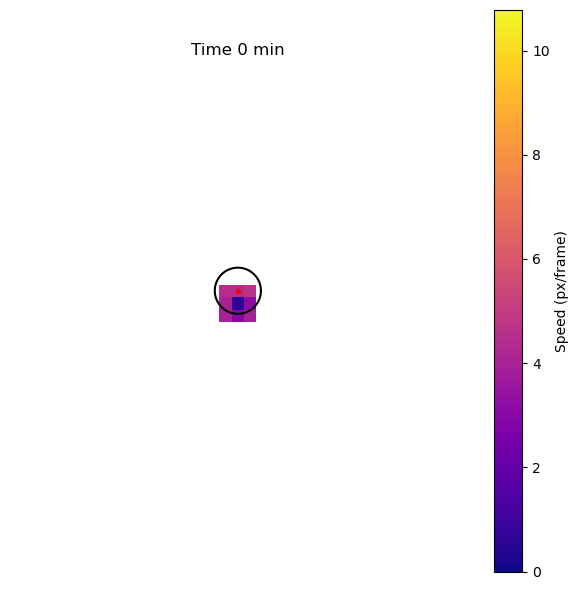

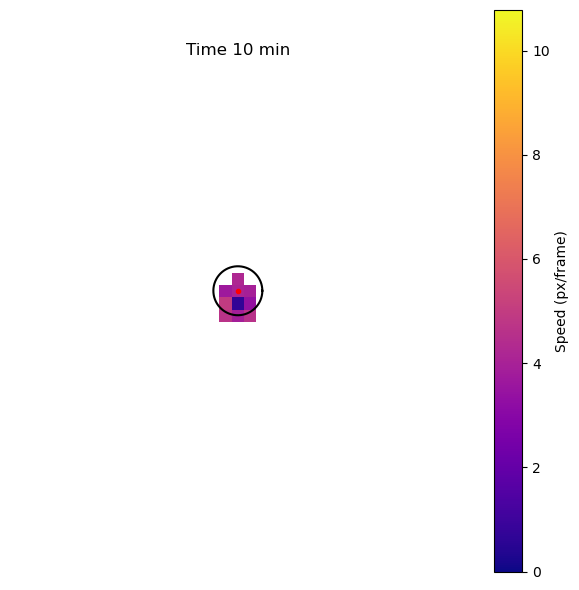

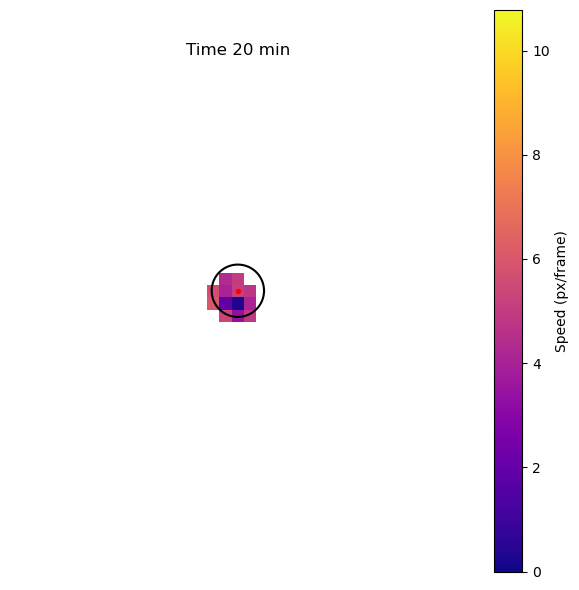

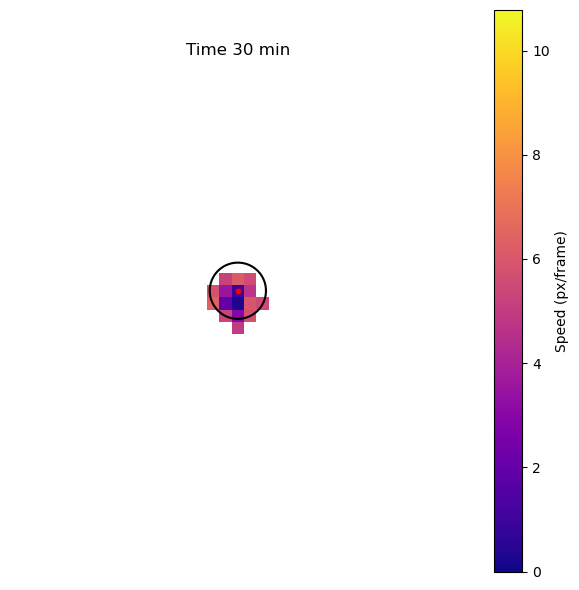

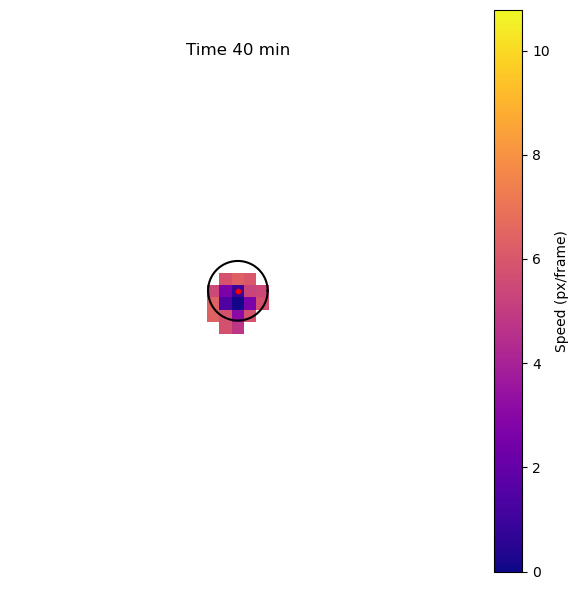

...

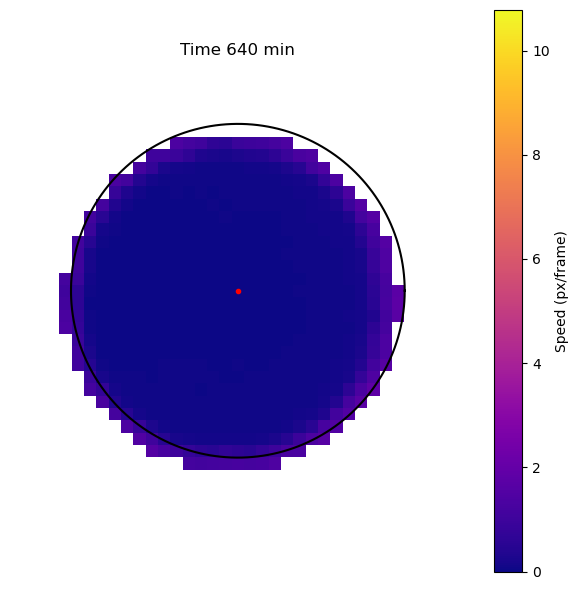

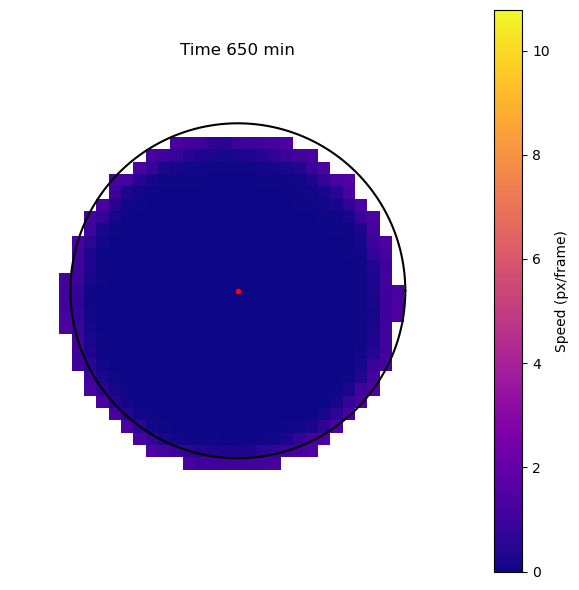

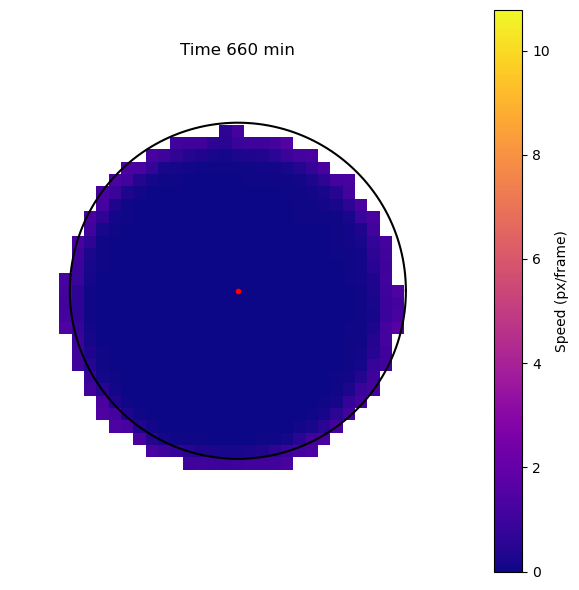

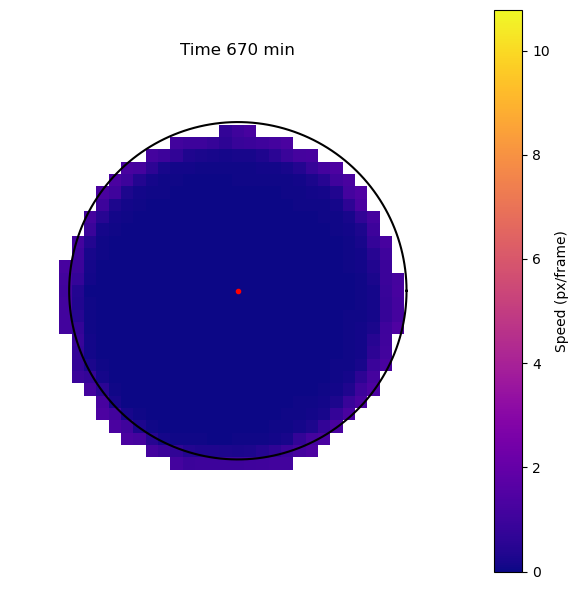

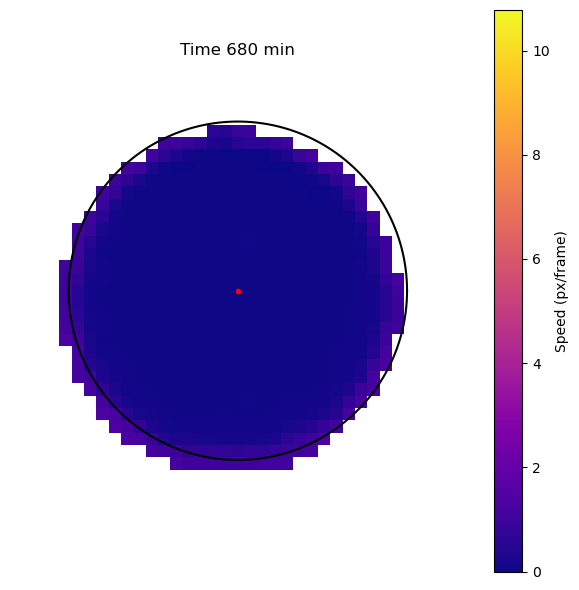

In [67]:
import matplotlib.pyplot as plt
import numpy as np

speed = np.linalg.norm(vel, axis=3)
H, W, T = speed.shape
center = (W / 2, H / 2)
scale_factor = W / 1200  # Assuming original image is 1200x1200

theta = np.linspace(0, 2 * np.pi, 200)

for t in range(tf):
    fig, ax = plt.subplots(figsize=(6, 6))

    # Plot heatmap
    im = ax.imshow(speed[:, :, t], cmap='plasma',
                   vmin=0, vmax=np.nanmax(speed),
                   extent=[0, W, 0, H], origin='lower')

    # Scale radius to match PIV grid size
    r = radius[t] * scale_factor
    x = center[0] + r * np.cos(theta)
    y = center[1] + r * np.sin(theta)

    ax.plot(x, y, color='black', linewidth=1.5)
    ax.plot(center[0], center[1], 'ro', markersize=3)  # center marker

    ax.set_xlim([0, W])
    ax.set_ylim([0, H])
    ax.set_aspect('equal')
    ax.axis('off')
    ax.set_title(f'Time {t*10} min')
    plt.colorbar(im, ax=ax, label='Speed (px/frame)')
    plt.tight_layout()
    plt.savefig(f'Heatmaps/speed_{t}.png', dpi=300)
    plt.show()

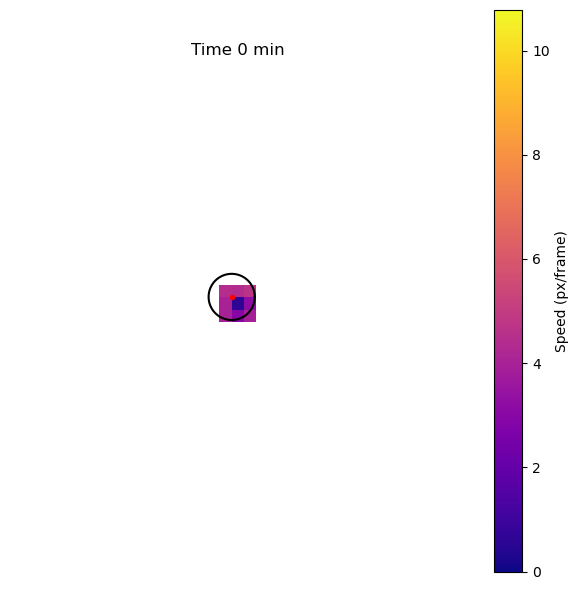

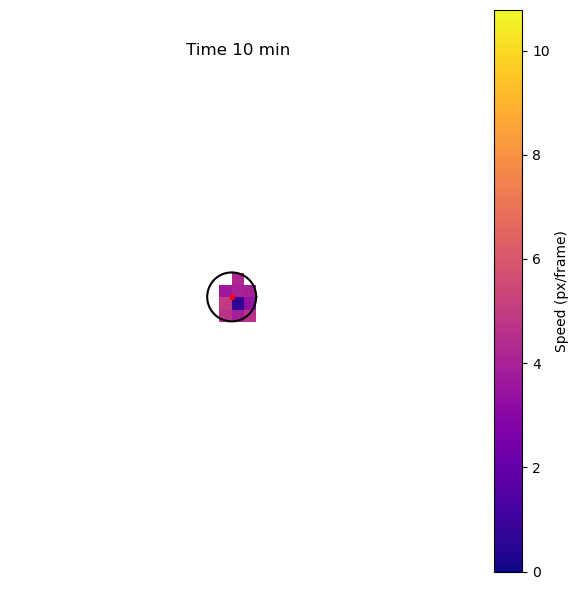

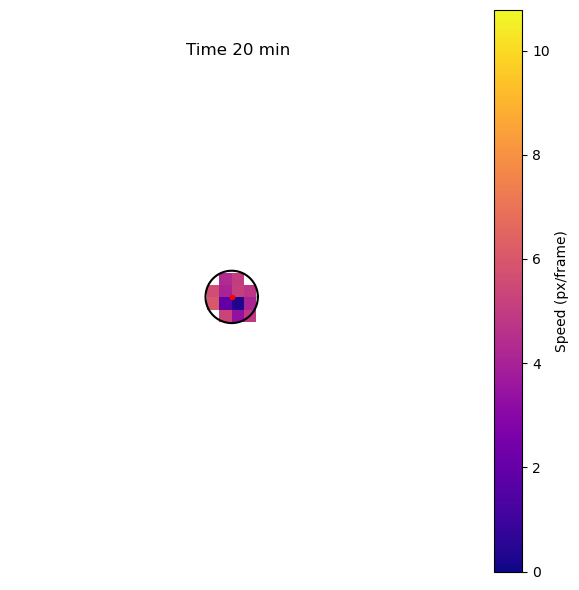

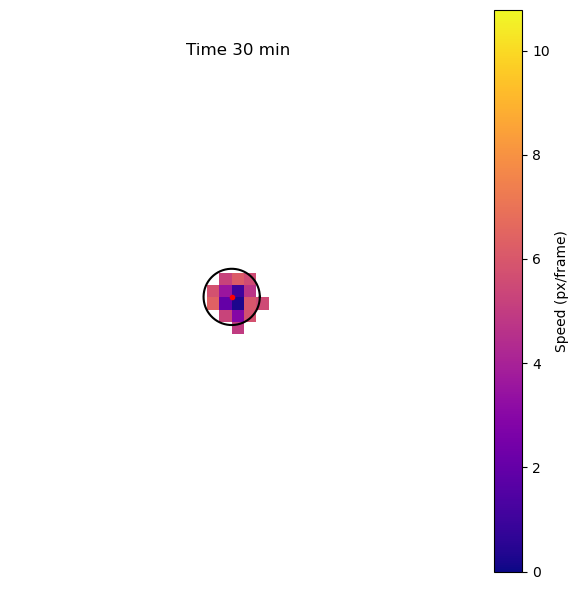

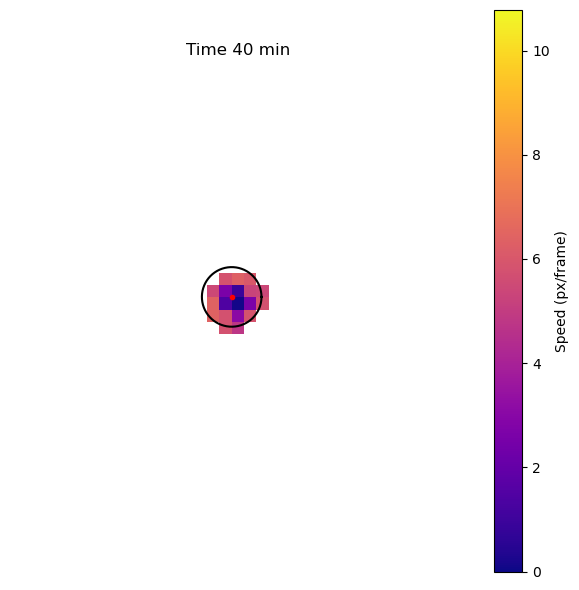

...

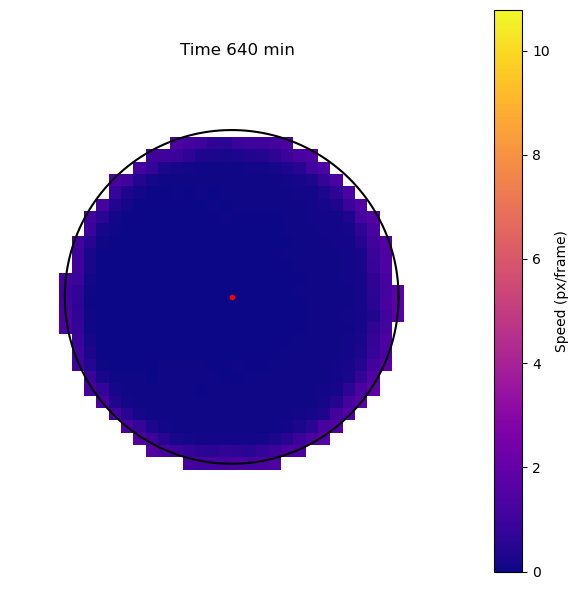

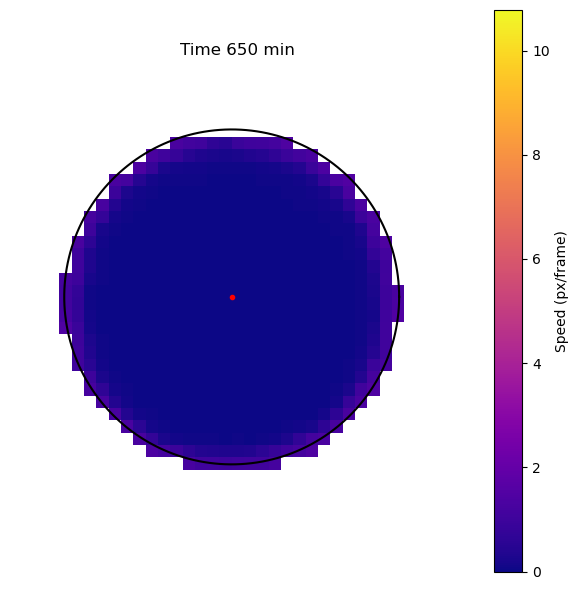

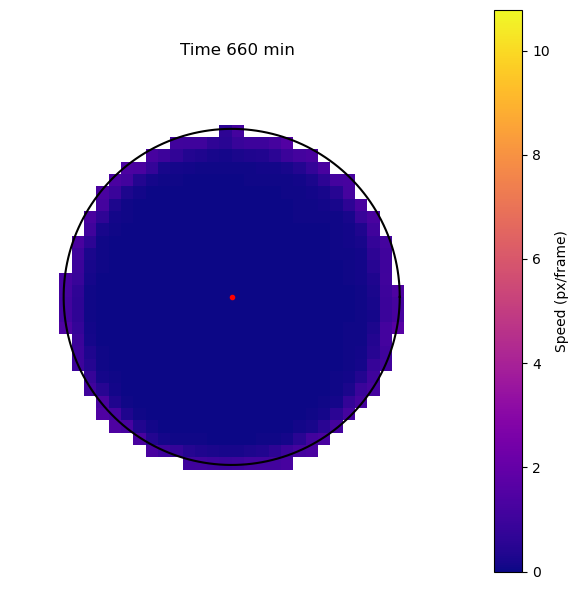

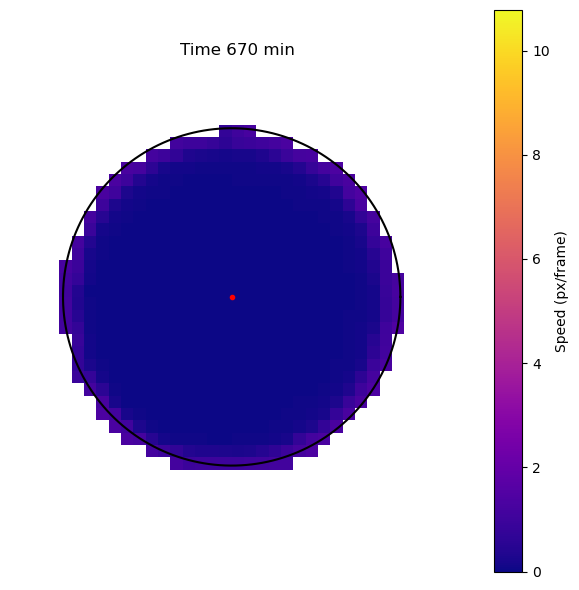

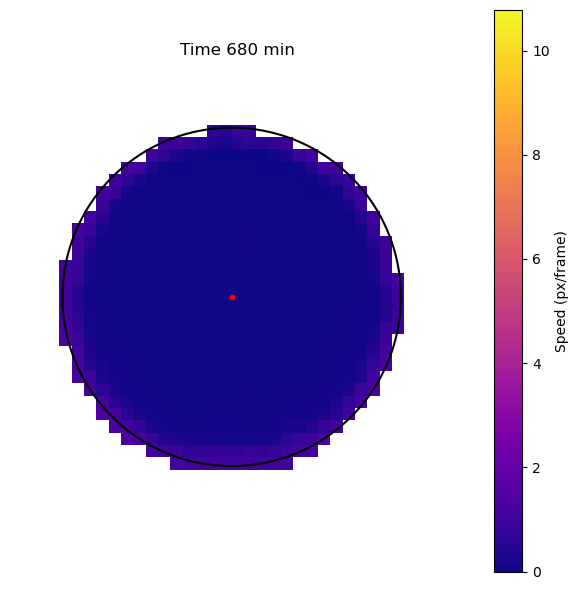

In [68]:
speed = np.linalg.norm(vel, axis=3)
H, W, T = speed.shape
scale_factor = W / 1200  # adjust if necessary
center = (W / 2 - 0.5, H / 2 - 0.5)  # shifted center

theta = np.linspace(0, 2 * np.pi, 200)

for t in range(tf):
    fig, ax = plt.subplots(figsize=(6, 6))

    im = ax.imshow(speed[:, :, t], cmap='plasma',
                   vmin=0, vmax=np.nanmax(speed),
                   extent=[0, W, 0, H], origin='lower')

    r = radius[t] * scale_factor
    x = center[0] + r * np.cos(theta)
    y = center[1] + r * np.sin(theta)

    ax.plot(x, y, color='black', linewidth=1.5)
    ax.plot(center[0], center[1], 'ro', markersize=3)

    ax.set_xlim([0, W])
    ax.set_ylim([0, H])
    ax.set_aspect('equal')
    ax.axis('off')
    ax.set_title(f'Time {t*10} min')
    plt.colorbar(im, ax=ax, label='Speed (px/frame)')
    plt.tight_layout()
    plt.savefig(f'Heatmaps/speed_{t}.png', dpi=300)
    plt.show()


In [49]:
print("speed shape:", speed.shape)        # should be (H, W, T)
print("speed[:,:,0] shape:", speed[:,:,0].shape)
print("images[0] shape:", images[0].shape)

speed shape: (37, 37, 69)
speed[:,:,0] shape: (37, 37)
images[0] shape: (1200, 1200)


In [51]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming speed shape is (H, W, T)
H, W, T = speed.shape
center = (H / 2, W / 2)  # approximate colony center in downsampled space

num_bins = 30
radius = np.sqrt((H/2)**2 + (W/2)**2)
r_bins = np.linspace(0, radius, num_bins + 1)
r_centers = 0.5 * (r_bins[:-1] + r_bins[1:])  # for plotting

# Compute radial distances
y, x = np.indices((H, W))
r = np.sqrt((x - center[1])**2 + (y - center[0])**2)

# Compute radial velocity profiles
radial_profiles = np.zeros((T, num_bins))
for t in range(T):
    speed_t = speed[:, :, t]
    for i in range(num_bins):
        mask = (r >= r_bins[i]) & (r < r_bins[i+1])
        radial_profiles[t, i] = np.nanmean(speed_t[mask])


/tmp/ipykernel_83190/745462373.py:23: RuntimeWarning: Mean of empty slice
  radial_profiles[t, i] = np.nanmean(speed_t[mask])


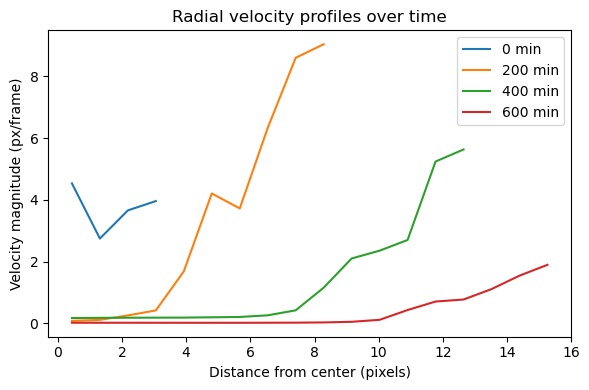

In [52]:
timepoints = [0, 20, 40, 60]  # Adjust as needed
time_labels = [f'{t*10} min' for t in timepoints]  # assuming 10 min/frame

plt.figure(figsize=(6, 4))
for t, label in zip(timepoints, time_labels):
    plt.plot(r_centers, radial_profiles[t], label=label)

plt.xlabel('Distance from center (pixels)')
plt.ylabel('Velocity magnitude (px/frame)')
plt.title('Radial velocity profiles over time')
plt.legend()
plt.tight_layout()
plt.savefig("radial_profiles.png", dpi=300)
plt.show()


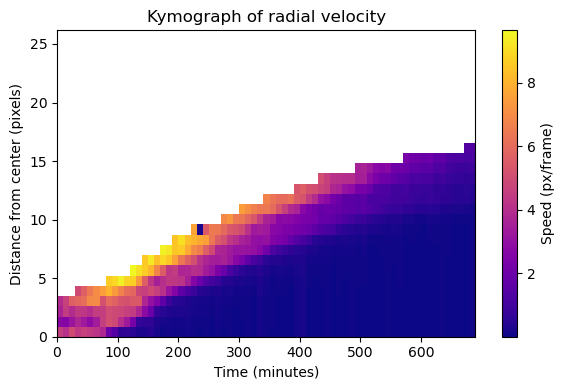

In [53]:
plt.figure(figsize=(6, 4))
plt.imshow(radial_profiles.T, aspect='auto', origin='lower', cmap='plasma',
           extent=[0, T*10, 0, radius])  # x=time, y=radius
plt.xlabel('Time (minutes)')
plt.ylabel('Distance from center (pixels)')
plt.title('Kymograph of radial velocity')
plt.colorbar(label='Speed (px/frame)')
plt.tight_layout()
plt.savefig("kymograph_velocity.png", dpi=300)
plt.show()

#### Example interrogation window

In [116]:
def plot_quivers_grid(images, pos, vel, w, h, tf=None, normed=False, single_timestep=None):
    """
    Plots quiver plots for velocity fields with optional single time step plotting.

    Parameters:
    - images: List of image frames
    - pos: Position array of the velocity field
    - vel: Velocity field array
    - w, h: Width and height of the image
    - tf: Total number of time steps (ignored if single_timestep is provided)
    - normed: Whether to normalize the velocity vectors
    - single_timestep: Specific time step to plot (optional)
    """
    time_steps = [single_timestep] if single_timestep is not None else range(tf)

    for t in time_steps:
        print(f"Time step: {t}")
        im = images[t]
        fig, ax = plt.subplots()
        
        # Display the image
        ax.imshow(im, cmap='gray')
        
        # Calculate normalization if needed
        if normed:
            norm = np.sqrt(vel[:, :, t, 0]**2 + vel[:, :, t, 1]**2)
        else:
            norm = 1
        
        # Extract velocity components
        vx = vel[:, :, t, 0]
        vy = vel[:, :, t, 1]
        
        # Quiver plot
        ax.quiver(w / 2 + pos[:, :, t, 1], h / 2 + pos[:, :, t, 0], vy / norm, -vx / norm, color='black')
        
        # Mark grid centers
        rows, cols = vel.shape[:2]  # Number of rows and columns in the grid
        for i in range(rows):
            for j in range(cols):
                grid_x = w / 2 + pos[i, j, t, 1]  # X-coordinate of the grid center
                grid_y = h / 2 + pos[i, j, t, 0]  # Y-coordinate of the grid center
                ax.plot(grid_x, grid_y, 'bo', markersize=1)  # Plot a blue point

        # Remove axis labels and ticks
        ax.set_xticks([])
        ax.set_yticks([])
        ax.axis('off')
        
        plt.tight_layout()
        # Save or display the plot
        #plt.savefig(f'Quivers/quiver_{t}.png', bbox_inches='tight', pad_inches=0)
        plt.savefig(f'single_quiver.png', bbox_inches='tight', pad_inches=0, dpi=300)
        plt.show()


Time step: 32


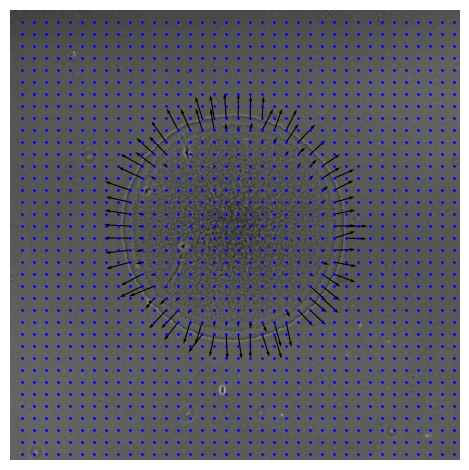

In [ ]:
plot_quivers_grid(im_all[:,:,:,ph_chn], pos, vel, 64, 64, single_timestep=32)

In [42]:
vel.shape

(37, 37, 69, 2)

In [114]:
def plot_quivers_zoom(images, pos, vel, w, h, time_steps=None, zoom_square=None, normed=False, show_quivers=None):
    """
    Plots the quiver plot with optional zoom into a specific square and dynamically scales arrows.

    Parameters:
    - images: List of image frames
    - pos: Position array of the velocity field
    - vel: Velocity field array
    - w, h: Width and height of the image
    - time_steps: List of specific time steps to plot (e.g., [33, 34])
    - zoom_square: Tuple (row, col) specifying which square to zoom into (optional)
    - normed: Whether to normalize the velocity vectors
    - show_quivers: List of booleans indicating whether to show quivers for each time step (optional)
    """
    if time_steps is None:
        time_steps = range(len(images))  # Default to all time steps if not provided

    if show_quivers is None:
        show_quivers = [True] * len(time_steps)  # Default to showing quivers for all time steps

    assert len(show_quivers) == len(time_steps), "Length of 'show_quivers' must match 'time_steps'"

    for t_idx, t in enumerate(time_steps):
        print(f"Time step: {t}")
        im = images[t]
        fig, ax = plt.subplots()
        
        # Display the image
        ax.imshow(im, cmap='gray')
        
        # Calculate normalization if needed
        if normed:
            norm = np.sqrt(vel[:, :, t, 0]**2 + vel[:, :, t, 1]**2)
        else:
            norm = 1
        
        # Extract velocity components
        vx = vel[:, :, t, 0]
        vy = vel[:, :, t, 1]
        
        # Set up default scale for arrows
        arrow_scale = 1.0
        
        # Zoom into the specified square
        if zoom_square:
            rows, cols = vel.shape[:2]
            row, col = zoom_square
            if 0 <= row < rows and 0 <= col < cols:
                square_center_x = w / 2 + pos[row, col, t, 1]
                square_center_y = h / 2 + pos[row, col, t, 0]
                
                # Define the zoom range
                zoom_range_x = (square_center_x - w / 2, square_center_x + w / 2)
                zoom_range_y = (square_center_y - h / 2, square_center_y + h / 2)
                
                ax.set_xlim(zoom_range_x)
                ax.set_ylim(zoom_range_y)
                
                # Scale arrows for zoomed region
                arrow_scale = 10  # Increase this value for larger arrows in zoom
        
        # Quiver plot
        if show_quivers[t_idx]:
            ax.quiver(w / 2 + pos[:, :, t, 1], h / 2 + pos[:, :, t, 0], vy / norm, vx / norm,
                      color='black', scale=arrow_scale,width=0.03)
        
        # Mark grid centers
        rows, cols = vel.shape[:2]
        for i in range(rows):
            for j in range(cols):
                grid_x = w / 2 + pos[i, j, t, 1]
                grid_y = h / 2 + pos[i, j, t, 0]
                ax.plot(grid_x, grid_y, 'bo', markersize=1)
        
        # Remove axis labels and ticks
        ax.set_xticks([])
        ax.set_yticks([])
        ax.axis('off')
        
        plt.tight_layout()
        # Save or display the plot
        # plt.savefig(f'Quivers/quiver_{t}.png', bbox_inches='tight', pad_inches=0)
        plt.savefig(f'quiver_zoom_{t}.png', bbox_inches='tight', pad_inches=0)
        
        plt.show()


Time step: 31


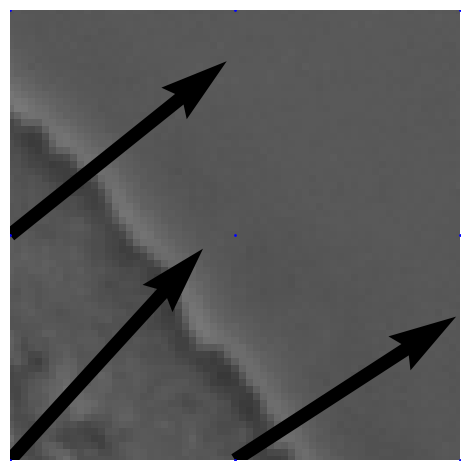

Time step: 32


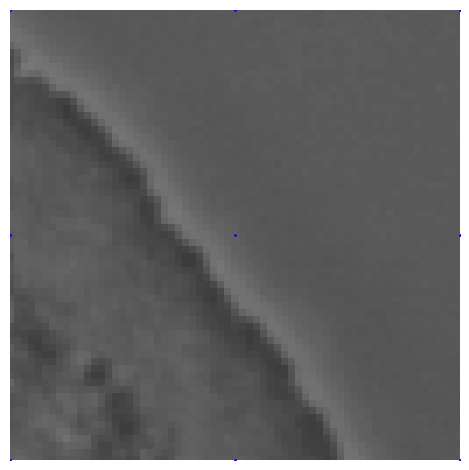

In [115]:
#plot_quivers_zoom(im_all[:,:,:,ph_chn], pos, vel, 64, 64, time_steps=[33, 34], zoom_square=(8, 18))
"""
plot_quivers_zoom(
    im_all[:,:,:,ph_chn], pos, vel, 64, 64,
    time_steps=[33, 34],
    zoom_square=(8, 18),
    show_quivers=[True, False]
)
"""
plot_quivers_zoom(
    im_all[:,:,:,ph_chn], pos, vel, 64, 64,
    #time_steps=[33, 34],
    time_steps=[31, 32],
    # this works
    #zoom_square=(26, 18),
    zoom_square=(23, 25),
    show_quivers=[True, False]
)

In [9]:
exp_sum

,Date,Machine,Strain,DNA,Chemical,Dilution,formatted_dates
0,2023-11-15,Ti scope,MC4100 & DHL708,pLPT20&pLPT41,-,10^(-5),2023_11_15
1,2023-11-15,Tweez scope,MC4100 & DHL708,pLPT20&pLPT41,-,10^(-6),2023_11_15
2,2023-11-17,Ti scope,DHL708,pLPT119&pLPT41,-,10^(-5),2023_11_17
3,2023-11-17,Tweez scope,MC4100 & DHL708,pLPT119&pLPT41,-,10^(-6),2023_11_17
4,2023-11-28,Ti scope,MC4100 & MG1655,pAAA,-,10^(-6),2023_11_28
5,2023-11-28,Tweez scope,MG1655,pAAA,-,10^(-5),2023_11_28
6,2023-11-30,Ti scope,MC4100,pAAA,-,10^(-6),2023_11_30
7,2023-11-30,Tweez scope,MC4100,pAAA,-,10^(-5),2023_11_30
8,2023-12-04,Ti scope,MC4100,pLPT107&pLPT41,IPTG,10^(-6),2023_12_04
9,2023-12-04,Tweez scope,MC4100,pLPT107&pLPT41,IPTG,10^(-5),2023_12_04


In [10]:
df = pd.read_excel('../data_processed.xlsx')
for i in [6]:    
    exp_date = exp_sum.loc[i,'formatted_dates']
    vector = exp_sum.loc[i,'DNA']
    scope_name = exp_sum.loc[i,'Machine']
    path_scope = os.path.join(path_ext, scope_name)
    path = os.path.join(path_scope, exp_date)
    
    df_pos = df[(df.Date == exp_sum.loc[i, 'Date']) & 
        (df.DNA == vector) & 
        (df.Machine == scope_name)]
    poss = df_pos.Position.unique()
    for pos in [0]:
        incub = df_pos[df_pos.Position == pos]['incub_time'].values[0]
        

In [11]:
start_minutes = 373
increments = [100, 200, 300, 400, 500, 600]

# Generate the time points
time_points = [(datetime.datetime(1, 1, 1, 0, 0) + datetime.timedelta(minutes=start_minutes + inc)).strftime("%H:%M") for inc in increments]

print(time_points)

['07:53', '09:33', '11:13', '12:53', '14:33', '16:13']


In [12]:
time_points = ['8 h', '9.5 h', '11 h', '13 h', '14.5 h', '16 h']

#### Model versus velocimetry

In [13]:
exp_sum = pd.read_excel('../Exps_summary.xlsx')
exp_sum['formatted_dates'] = exp_sum['Date'].dt.strftime('%Y_%m_%d')
positions = pd.read_excel('../Positions.xlsx')
df = pd.read_excel('../data_processed.xlsx')

#### Single position

#### Model prediction vs data at different time points

In [14]:
## It's all in pixels, not um
nt, nx, ny, nc = im_all.shape
start_frame = 0
t0 = 10
tf = 68
step = 1

vmag = np.load(os.path.join(path_results, 'vmag.npy'))
vmag = vmag[t0:tf, :, :]
nt, nx, ny = vmag.shape
vfront = np.load(os.path.join(path_results, 'vfront.npy'))
rmax = np.load(os.path.join(path_results, 'radius.npy'))
idx = np.arange(start_frame+t0,nt+start_frame+t0)
vfront = vfront[idx]
rmax = rmax[idx]
svmag = np.load(os.path.join(path_results, 'svmag.npy'))
edt = np.load(os.path.join(path_results, 'edt.npy'))
edt = edt[idx, :, :]
r0 = np.load(os.path.join(path_results, 'r0.npy'))

/tmp/ipykernel_8481/2125046194.py:25: RuntimeWarning: invalid value encountered in double_scalars
  model_vmag = B * (((R - r - r0) * np.exp(-r / r0) + r0 * np.exp(-R / r0)) / (R - r))
/tmp/ipykernel_8481/2125046194.py:26: RuntimeWarning: Mean of empty slice
  mean_model_vmag = np.nanmean(model_vmag)


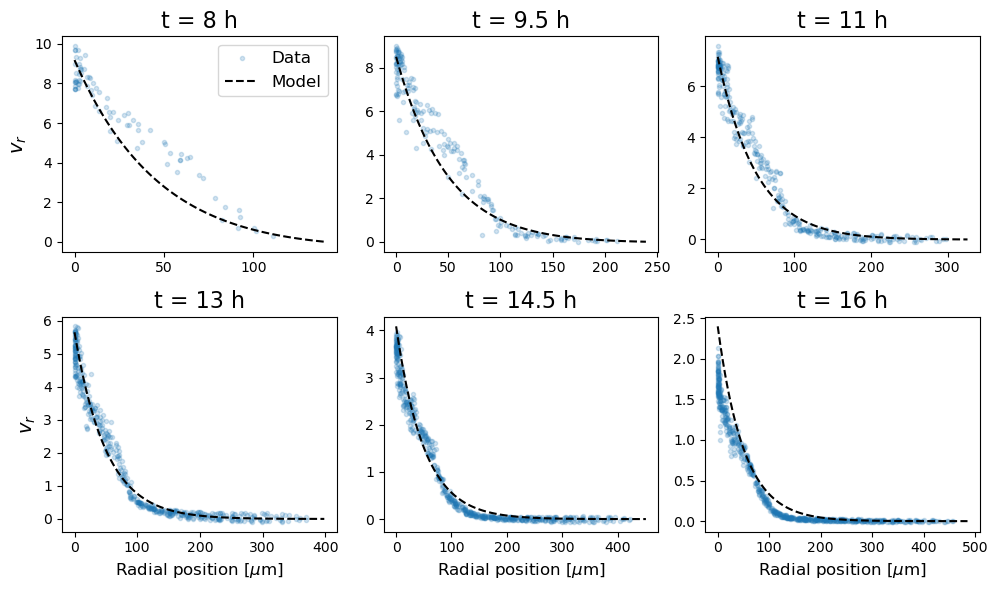

In [15]:
# Make a plot to see how good the fit is
# This is adjusted by um_px = 1.14 for Ti microscope
i = 0
step = 1
times = [0,10,20,30,40,50]#np.linspace(0, nt - 1, 12).astype(int)  # [0,int(nt/3),int(2*nt/3),nt-1]
plt.figure(figsize=(10,6))
for t in times:
    plt.subplot(2, 3, i + 1)
    x_model = np.zeros((0,))
    y_model = np.zeros((0,))
    x_data = np.zeros((0,))
    y_data = np.zeros((0,))

    for ix in range(nx):
        for iy in range(ny):
            if not np.isnan(svmag[t, ix, iy]):
                r = edt[t, ix * 32:ix * 32 + 64, iy * 32:iy * 32 + 64]
                #r = edt[t, ix * 16:ix * 16 + 32, iy * 16:iy * 16 + 32]
                x_data = np.append(x_data, np.nanmean(r))
                y_data = np.append(y_data, svmag[t, ix, iy])
    plt.plot(x_data*1.14, y_data, '.', alpha=0.2)  # , color=colours[i])

    for r in np.linspace(0, rmax[t], 100):
        R = rmax[t]
        B = R / ((R - r0) + r0 * np.exp(-R / r0))    
        model_vmag = B * (((R - r - r0) * np.exp(-r / r0) + r0 * np.exp(-R / r0)) / (R - r))
        mean_model_vmag = np.nanmean(model_vmag)
        x_model = np.append(x_model, np.nanmean(r))
        y_model = np.append(y_model, vfront[step * t] * mean_model_vmag)

    #plt.plot(x_model, y_model, 'k--')  # , color=colours[i])
    plt.plot(x_model*1.14, y_model, 'k--')  # , color=colours[i])


    #plt.title(f't = {idx[t]}')
    plt.title(f't = {time_points[i]}', fontsize=16)
    if i == 0 or i == 3:
        plt.ylabel('$v_r$', fontsize=14)
    if i == 3 or i == 4 or i == 5:
        plt.xlabel('Radial position [$\mu$m]', fontsize=12)
    if i==0:
        plt.legend(['Data', 'Model'], fontsize=12)
    i += 1
plt.tight_layout()
plt.savefig('vfront_rad.png', dpi=300)
plt.show()

#### Model prediction vs data

In [16]:
exp_sum = pd.read_excel('../Exps_summary.xlsx')
exp_sum['formatted_dates'] = exp_sum['Date'].dt.strftime('%Y_%m_%d')
positions = pd.read_excel('../Positions.xlsx')
df = pd.read_excel('../data_processed.xlsx')

In [17]:
y_model = np.array([])
y_data = np.array([])
for i in [6]:    
    exp_date = exp_sum.loc[i,'formatted_dates']
    vector = exp_sum.loc[i,'DNA']
    scope_name = exp_sum.loc[i,'Machine']
    path_scope = os.path.join(path_ext, scope_name)
    path = os.path.join(path_scope, exp_date)
    
    df_pos = df[(df.Date == exp_sum.loc[i, 'Date']) & 
        (df.DNA == vector) & 
        (df.Machine == scope_name)]
    poss = df_pos.Position.unique()

    for pos in [0]:
        #if df_pos.loc[col,'r0'] > 1:
        path_results = os.path.join(path, folder_results, f"pos{pos}")
        y_model = np.load(os.path.join(path_results, 'y_model.npy'))
        y_data = np.load(os.path.join(path_results, 'y_data.npy'))

In [18]:
np.corrcoef(y_model, y_data)

array([[1.        , 0.98024346],
       [0.98024346, 1.        ]])

In [19]:
r_squared = r2_score(y_data, y_model)
print("R^2:", r_squared)

R^2: 0.957203165512001


In [20]:

y = y_data
x = y_model
"""
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
fig, ax = plt.subplots()
scatter = ax.scatter(x, y, c=z, s=100, cmap='viridis')
plt.plot(np.arange(0, 11), np.arange(0, 11), 'k--')
plt.colorbar(scatter, label='Density')
plt.title('Model vs Experimental Data')
plt.xlabel('Data')
plt.ylabel('Model')
plt.grid(True)
plt.savefig('')
plt.show()
"""

"\nxy = np.vstack([x,y])\nz = gaussian_kde(xy)(xy)\nfig, ax = plt.subplots()\nscatter = ax.scatter(x, y, c=z, s=100, cmap='viridis')\nplt.plot(np.arange(0, 11), np.arange(0, 11), 'k--')\nplt.colorbar(scatter, label='Density')\nplt.title('Model vs Experimental Data')\nplt.xlabel('Data')\nplt.ylabel('Model')\nplt.grid(True)\nplt.savefig('')\nplt.show()\n"

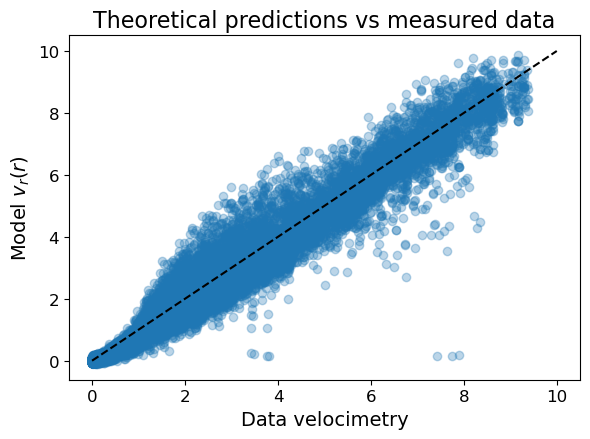

In [47]:
fig, ax = plt.subplots(figsize=(6,4.5))
scatter = ax.scatter(x, y, alpha=0.3)
plt.plot(np.arange(0,11), np.arange(0,11), 'k--')
plt.title('Theoretical predictions vs measured data', fontsize=16)
plt.xlabel('Data velocimetry', fontsize=14)
plt.ylabel('Model $v_r(r)$', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.grid(True)
plt.tight_layout()
plt.savefig('model_vs_velocimetry.png', dpi=300)
plt.show()

#### All positions

In [22]:
y_models = np.array([])
y_datas = np.array([])
for i in exp_sum.index.values:    
    exp_date = exp_sum.loc[i,'formatted_dates']
    vector = exp_sum.loc[i,'DNA']
    scope_name = exp_sum.loc[i,'Machine']
    path_scope = os.path.join(path_ext, scope_name)
    path = os.path.join(path_scope, exp_date)
    
    df_pos = df[(df.Date == exp_sum.loc[i, 'Date']) & 
        (df.DNA == vector) & 
        (df.Machine == scope_name)]
    #poss = df_pos.Position.unique()

    for col in df_pos.index.values:
        if df_pos.loc[col,'r0'] > 1:
            path_results = os.path.join(path, folder_results, f"pos{df_pos.loc[col,'Position']}")
            y_model = np.load(os.path.join(path_results, 'y_model.npy'))
            y_data = np.load(os.path.join(path_results, 'y_data.npy'))
            y_models = np.concatenate((y_models, y_model))
            y_datas = np.concatenate((y_datas, y_data))
np.corrcoef(y_models,y_datas)

array([[1.        , 0.96095162],
       [0.96095162, 1.        ]])

In [23]:
np.corrcoef(y_models,y_datas)


array([[1.        , 0.96095162],
       [0.96095162, 1.        ]])

In [24]:
r_squared = r2_score(y_datas, y_models)
print("R^2:", r_squared)

R^2: 0.9125823693124734


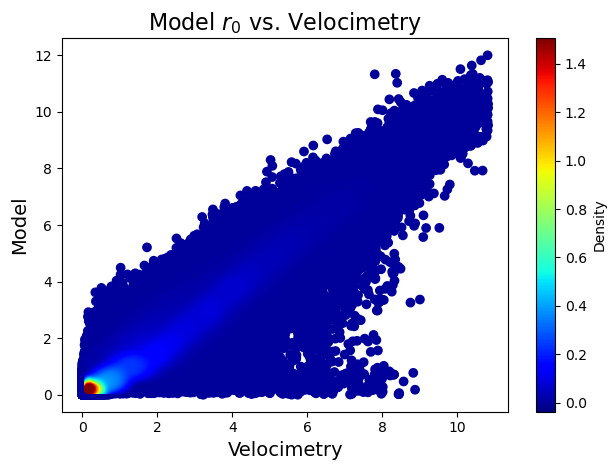

In [129]:
from matplotlib import cm
from matplotlib.colors import Normalize 
from scipy.interpolate import interpn

bins = [30, 30]
y = y_datas[y_datas > 0]
x = y_models[y_datas > 0]
fig, ax = plt.subplots()
data, x_e, y_e = np.histogram2d(x, y, bins=bins, density=True)
z = interpn((0.5 * (x_e[1:] + x_e[:-1]), 0.5 * (y_e[1:] + y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)

# To be sure to plot all data
z[np.where(np.isnan(z))] = 0.0

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], y[idx], z[idx]

# Scatter plot
sc = ax.scatter(x, y, c=z, cmap='jet')

# Colorbar
norm = Normalize(vmin=np.min(z), vmax=np.max(z))
cbar = fig.colorbar(cm.ScalarMappable(norm=norm, cmap='jet'), ax=ax)
cbar.ax.set_ylabel('Density')

# Add title and labels
ax.set_title('Model vs Velocimetry', fontsize=16)
ax.set_title('Model $r_0$ vs. Velocimetry', fontsize=16)
ax.set_xlabel('Velocimetry', fontsize=14)
ax.set_ylabel('Model', fontsize=14)

# Show plot
plt.tight_layout()
plt.savefig('model_vs_velocimetry.png', dpi=300)
plt.show()

#### Histogram of r0

##### If two dilutions are not statistically different

In [25]:
exp_sum = pd.read_excel('../Exps_summary.xlsx')
exp_sum['formatted_dates'] = exp_sum['Date'].dt.strftime('%Y_%m_%d')
positions = pd.read_excel('../Positions.xlsx')
df = pd.read_excel('../data_processed.xlsx')

df_r0 = df[df.r0_um > 0.1]
#idx = df[df.r0_um > 0.1].index
area = df_r0['area_max_um']#[idx]
radius = np.sqrt(area/np.pi)
r0 = df_r0['r0_um']

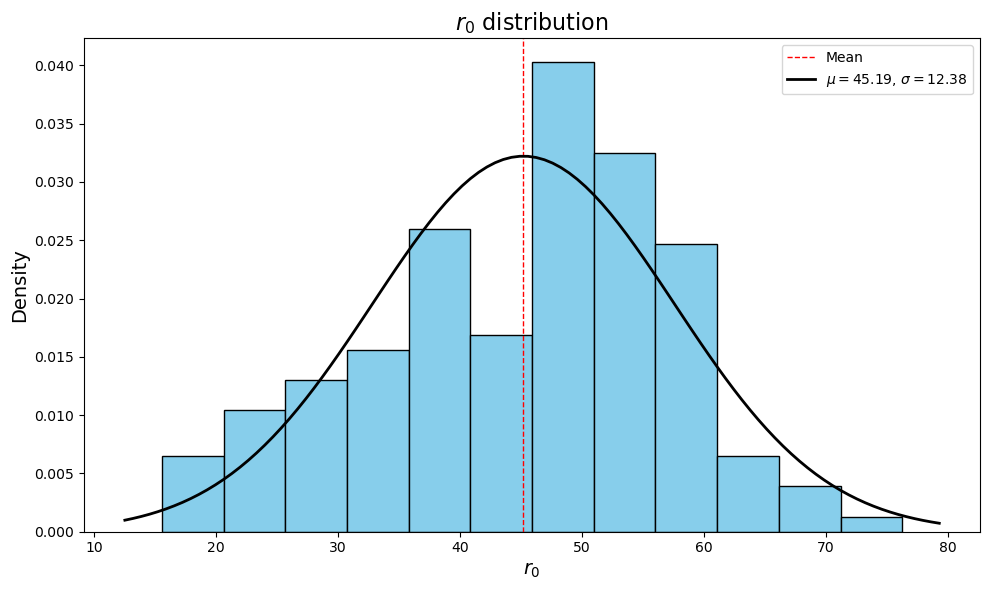

Mean (mu): 45.18810820518733
Standard Deviation (sigma): 12.384705333057608


In [26]:
from scipy.stats import norm

# Your existing data selection
data = df_r0['r0_um']

## Square Root Method: Use the square root of the total number of data points.
num_bins = int(np.sqrt(len(data)))

# Calculate the mean and standard deviation of the data
mu, std = norm.fit(data)

# Create a histogram
plt.figure(figsize=(10, 6))
plt.hist(data, bins=num_bins, density=True, color='skyblue', edgecolor='black', alpha=1)

# Add labels and title
plt.xlabel('$r_0$', fontsize=14)
plt.ylabel('Density', fontsize=14)
plt.title('$r_0$ distribution', fontsize=16)

# Add lines for mean and median
mean = np.mean(data)
#median = np.median(data)
plt.axvline(mean, color='red', linestyle='dashed', linewidth=1, label=f'Mean')
#plt.axvline(median, color='green', linestyle='dashed', linewidth=1, label=f'Median')

# Plot the normal distribution curve
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2, label=f'$\mu={mu:.2f}$, $\sigma={std:.2f}$')

# Add legend
plt.legend()

# Show the plot
plt.tight_layout()

plt.savefig('r0_hist_normal_fit.png', dpi=300)
plt.show()

# Print the normal distribution parameters
print(f'Mean (mu): {mu}')
print(f'Standard Deviation (sigma): {std}')


In [25]:
df = pd.read_excel('../data_processed.xlsx')
df_r0 = df#[df.r0_um > 0.1]
r0 = df_r0['r0_um']

In [26]:
radius = df_r0['rad_max_um']

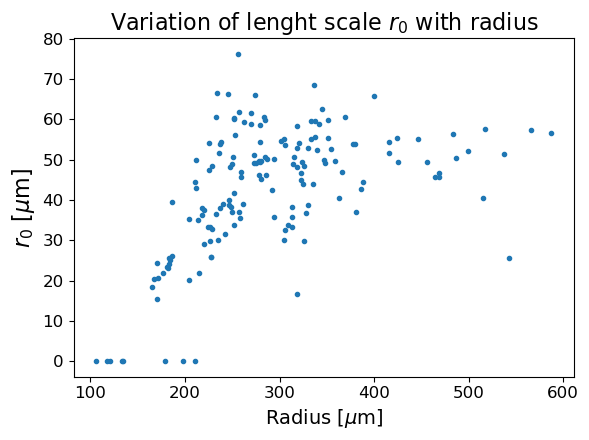

In [45]:
plt.figure(figsize=(6,4.5))

# Plot the data
#plt.plot(np.log(radius), r0, '.')
plt.plot(radius,r0,'.')

# Set the title and axis labels with desired font sizes
plt.title('Variation of lenght scale $r_0$ with radius', fontsize=16)
plt.xlabel('Radius [$\mu$m]', fontsize=14)
plt.ylabel('$r_0$ [$\mu$m]', fontsize=16)

# Set the tick label sizes
plt.tick_params(axis='both', which='major', labelsize=12)  # Set the tick size for both x and y axes
#plt.xlim([0,650])
#plt.ylim([0,80])
# Ensure layout is tight
plt.tight_layout()
plt.savefig('r0_rad_all.png', dpi=300)
# Display the plot
plt.show()

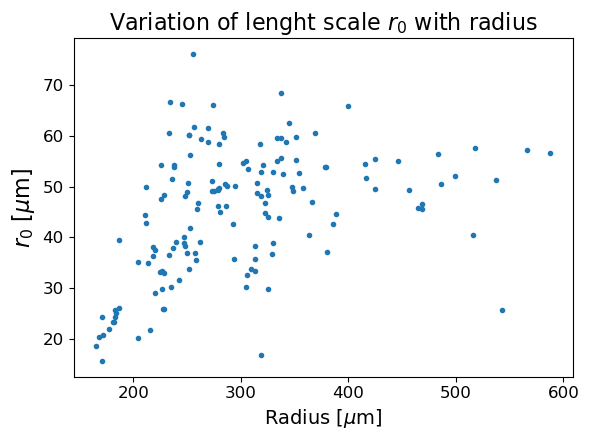

In [44]:
plt.figure(figsize=(6,4.5))

# Plot the data
#plt.plot(np.log(radius), r0, '.')
plt.plot(df[df.r0_um > 0.1]['rad_max_um'],df[df.r0_um > 0.1]['r0_um'],'.')

# Set the title and axis labels with desired font sizes
plt.title('Variation of lenght scale $r_0$ with radius', fontsize=16)
plt.xlabel('Radius [$\mu$m]', fontsize=14)
plt.ylabel('$r_0$ [$\mu$m]', fontsize=16)

# Set the tick label sizes
plt.tick_params(axis='both', which='major', labelsize=12)  # Set the tick size for both x and y axes
#plt.xlim([0,650])
#plt.ylim([0,80])
# Ensure layout is tight
plt.tight_layout()
plt.savefig('r0_rad.png', dpi=300)
# Display the plot
plt.show()

In [43]:
df[df.r0_um < 0.1]['rad_max_um'].mean()

149.838801520875

In [46]:
np.corrcoef(r0,radius)

array([[1.        , 0.51429129],
       [0.51429129, 1.        ]])

In [35]:
df = pd.read_excel('../data_processed.xlsx')
df_r0 = df[df.r0_um > 0.1]

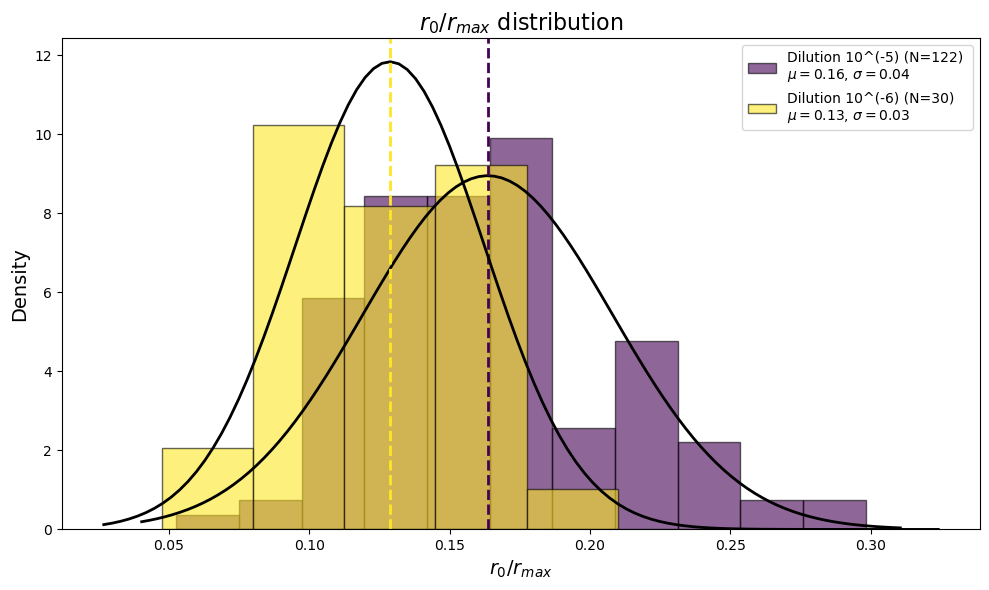

In [36]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

# Assuming df_r0 is already defined
dilutions = df_r0['Dilution'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(dilutions)))  # Using viridis color map

# Create a figure
plt.figure(figsize=(10, 6))

for i, dilution in enumerate(dilutions):
    # Select data for the current dilution
    data = df_r0[df_r0['Dilution'] == dilution]['r0_um']
    radius = df_r0[df_r0['Dilution'] == dilution]['rad_max_um']
    
    # Compute the ratio r0/radius
    ratio = data / radius
    
    # Calculate the number of samples
    N = len(ratio)
    
    # Square Root Method: Use the square root of the total number of data points.
    num_bins = int(np.sqrt(N))

    # Calculate the mean and standard deviation of the ratio
    mu, std = norm.fit(ratio)

    # Plot the histogram of the ratio
    plt.hist(ratio, bins=num_bins, density=True, color=colors[i], edgecolor='black', alpha=0.6, 
             label=f'Dilution {dilution} (N={N}) \n$\mu={mu:.2f}$, $\sigma={std:.2f}$')
    
    # Plot the normal distribution curve
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, color='black', linewidth=2)

    # Add a vertical line for the mean
    plt.axvline(mu, color=colors[i], linestyle='dashed', linewidth=2)

# Add labels and title
plt.xlabel('$r_0 / r_{max}$', fontsize=14)
plt.ylabel('Density', fontsize=14)
plt.title('$r_0 / r_{max}$ distribution', fontsize=16)

# Add legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()


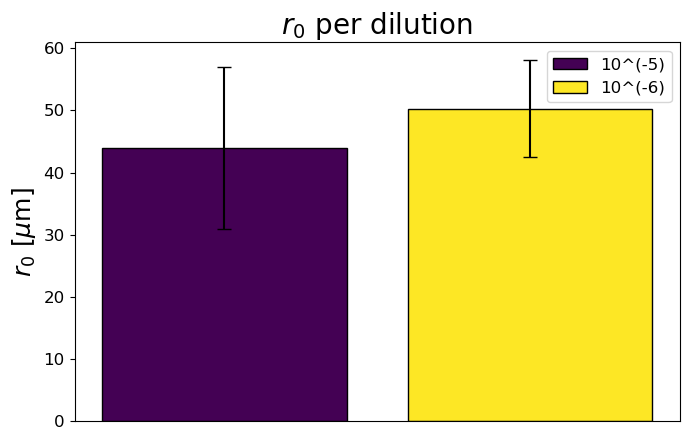

In [49]:
# Load the data
df = pd.read_excel('../data_processed.xlsx')
df = df[df.r0_um > 0.1]
df['time_traveling'] = df['time_wave_arrival'] - df['time_wave_start']

# Group the data by Dilution and calculate the statistics
grouped_df = df.groupby(['Dilution']).agg({
    'time_wave_start': ['mean', 'std'],
    'time_wave_arrival': ['mean', 'std'],
    'wave_speed_av': ['mean', 'std'],
    'time_traveling': ['mean', 'std'],
    'r0_um': ['mean', 'std'],
    'rad_max_um': ['mean', 'std'],
    'area_max_um': ['mean', 'std'],
    'Dilution': 'first',  # Include Dilution to keep it in the DataFrame
}).reset_index()

# Flatten the multi-level column index for easier access
grouped_df.columns = [
    col[0] if col[1] == '' else f'{col[0]}_{col[1]}'.strip('_')
    for col in grouped_df.columns
]

# Select only the dilutions you're interested in
selected_dilutions = grouped_df[grouped_df['Dilution'].isin(['10^(-5)', '10^(-6)'])]

# Generate colors for the two dilutions using the viridis color map
area_colors = plt.cm.viridis(np.linspace(0, 1, 2))

# Plotting function for all statistics
def plot_all_statistics():
    for stat_name, ylabel in [
        #('time_wave_start', 'Start Time'),
        #('time_wave_arrival', 'Arrival Time'),
        #('wave_speed_av', 'Wave Speed (um/h)'),
        #('time_traveling', 'Time Traveling'),
        ('r0_um', '$r_0$ [$\mu$m]'),
        #('rad_max_um', 'Max Radius (um)'),
        #('area_max_um', 'Max Area (um^2)')
    ]:
        fig, ax = plt.subplots(figsize=(7, 4.5))
        
        # Plot the data with specific colors for each dilution
        for pos, (index, row) in enumerate(selected_dilutions.iterrows()):
            ax.bar(pos, row[f'{stat_name}_mean'], yerr=row[f'{stat_name}_std'], capsize=5,
                   color=area_colors[pos], label=row['Dilution'], edgecolor='black')
        
        # Remove x-axis labels and ticks
        ax.set_xticks([])
        ax.set_xticklabels([])
        ax.set_xlabel('')  # Optionally clear the xlabel if it was set elsewhere
        
        # Add y-axis label and title
        ax.set_ylabel(ylabel, fontsize=18)
        #ax.set_title(f'{ylabel} per dilution', fontsize=20)
        ax.set_title('$r_0$ per dilution', fontsize=20)
        # Set the size of y-ticks
        ax.tick_params(axis='y', labelsize=12)  # Set y-tick size here (e.g., 12)

        # Add legend
        ax.legend(fontsize=12)
        
        # Tight layout
        plt.tight_layout()
        plt.savefig('r0_barplot.png',dpi=300)
        plt.show()

# Plot all the statistics
plot_all_statistics()


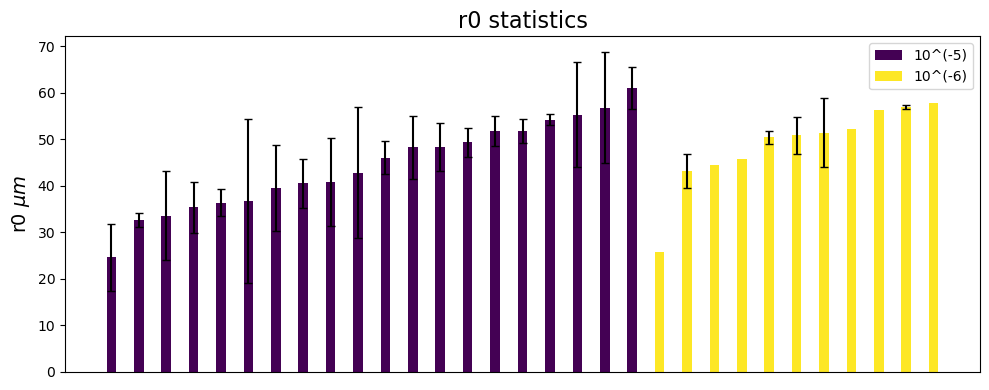

In [92]:
# Load the data
df = pd.read_excel('../data_processed.xlsx')
df = df[df.r0_um > 0.1]

# Calculate time traveling for each colony
df['time_traveling'] = df['time_wave_arrival'] - df['time_wave_start']

# Group the data by Date, Machine, Dilution, and Pad, and calculate the statistics, including the number of colonies per pad
grouped_df = df.groupby(['Date', 'Machine', 'Dilution', 'Pad']).agg({
    'Pad': 'count',  # Count the number of colonies (assuming one row per colony)
    'time_wave_start': ['mean', 'std'],
    'time_wave_arrival': ['mean', 'std'],
    'wave_speed_av': ['mean', 'std'],
    'time_traveling': ['mean', 'std'],
    'r0_um': ['mean', 'std'],
    'rad_max_um': ['mean', 'std'],
    'area_max_um': ['mean', 'std'],
    'Dilution': 'first',  # Include Dilution to keep it in the DataFrame
}).reset_index()

# Flatten the multi-level column index for easier access
grouped_df.columns = [
    col[0] if col[1] == '' else f'{col[0]}_{col[1]}'.strip('_')
    for col in grouped_df.columns
]

# Sort the data by 'Dilution' first, then within each dilution by 'r0_um_mean' in ascending order
grouped_df.sort_values(['Dilution', 'r0_um_mean'], ascending=[True, True], inplace=True)

# Set up the bar width and index for plotting
bar_width = 0.35
index = np.arange(len(grouped_df))

# Generate colors for the two dilutions using the viridis color map
area_colors = plt.cm.viridis(np.linspace(0, 1, 2))

# Function to plot each statistic
def plot_statistic(stat_mean, stat_std, title, ylabel, filename):
    fig, ax = plt.subplots(figsize=(10, 4))
    
    added_labels = { '10^(-5)': False, '10^(-6)': False }  # Track which labels have been added
    
    # Plot bars with error bars, assigning colors based on Dilution
    for i, (pos, row) in enumerate(grouped_df.iterrows()):
        if row['Dilution'] == '10^(-5)':
            color = area_colors[0]
            if not added_labels['10^(-5)']:
                ax.bar(i, row[stat_mean], bar_width, yerr=row[stat_std], capsize=3, color=color, label='10^(-5)')
                added_labels['10^(-5)'] = True  # Mark as added to the legend
            else:
                ax.bar(i, row[stat_mean], bar_width, yerr=row[stat_std], capsize=3, color=color)
        elif row['Dilution'] == '10^(-6)':
            color = area_colors[1]
            if not added_labels['10^(-6)']:
                ax.bar(i, row[stat_mean], bar_width, yerr=row[stat_std], capsize=3, color=color, label='10^(-6)')
                added_labels['10^(-6)'] = True  # Mark as added to the legend
            else:
                ax.bar(i, row[stat_mean], bar_width, yerr=row[stat_std], capsize=3, color=color)
    
    # Add labels and title
    #ax.set_xlabel('Combination (Date, Machine, Dilution, Pad)', fontsize=14)
    ax.set_ylabel(ylabel, fontsize=14)
    ax.set_title(title, fontsize=16)
    ax.set_xticks([])
    
    # Create the x-tick labels based on the actual column names
    #x_tick_labels = [
    #    f"{row['Date']}_{row['Machine']}_{row['Dilution_first']}_{row['Pad']}" 
    #    for _, row in grouped_df.iterrows()
    #]
    #ax.set_xticklabels(x_tick_labels, rotation=90, ha='center')
    
    # Add a legend
    ax.legend()
    
    # Adjust layout for better fit
    plt.tight_layout()
    
    # Save and show the plot
    plt.savefig(f'{filename}.png', dpi=300)  # Optionally save the plot
    plt.show()

# List of statistics to plot
stats_to_plot = [
    ('r0_um_mean', 'r0_um_std', 'r0 statistics', 'r0 $\mu m$', 'r0_statistics')
]

# Loop through the list and plot each statistic
for stat_mean, stat_std, title, ylabel, filename in stats_to_plot:
    plot_statistic(stat_mean, stat_std, title, ylabel, filename)
